In [1]:
import numpy as np
import pickle
import matplotlib.pyplot as plt
from scipy.io import loadmat
import visionloader as vl
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.cluster import KMeans, SpectralClustering
from sklearn.pipeline import make_pipeline
import os
import src.fitting as fitting
import src.multielec_utils as mutils
from mpl_toolkits.mplot3d import Axes3D
from scipy.optimize import minimize
import sys
sys.path.append('/Volumes/Lab/Users/jeffbrown/electrical_spike_sorting/utils/')
sys.path.append('/Volumes/Lab/Users/AlexG/pystim/python-libraries/')
import eilib_new as eil

%load_ext autoreload
%autoreload 2
%matplotlib ipympl

ModuleNotFoundError: No module named 'cython_extensions.visionfile_cext'

In [2]:
ANALYSIS_BASE = "/Volumes/Analysis"

# Periphery

# 2020-10-18-5/data006/data006-all_v2

/tmp/ipykernel_27464/3934846500.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


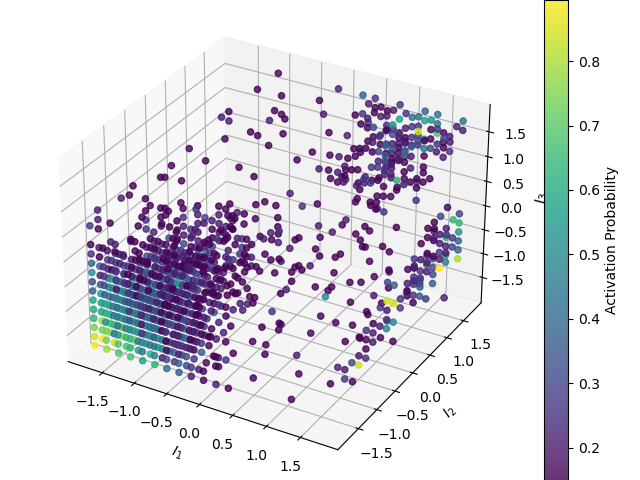

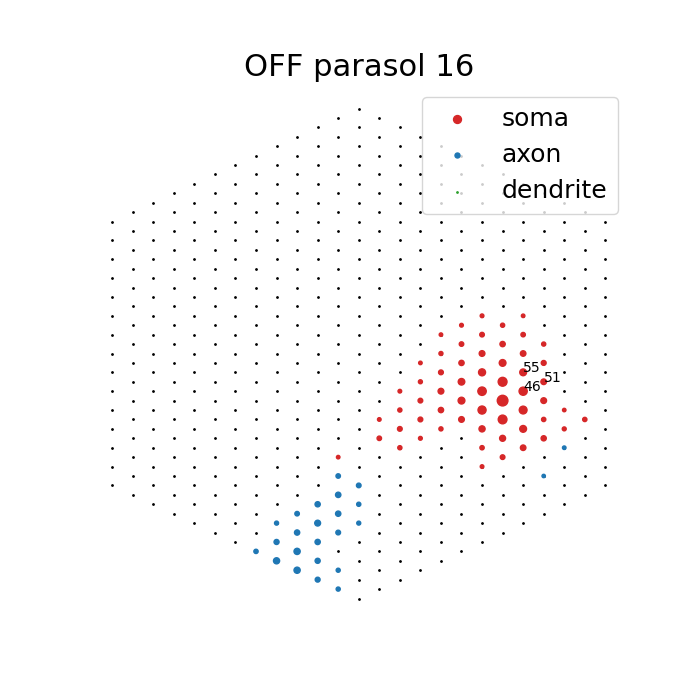

In [3]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_periphery-affinity_cosine"
dataset = "2020-10-18-5"
estim = "data006/data006-all_v2"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 1
n = 16

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/2617225152.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


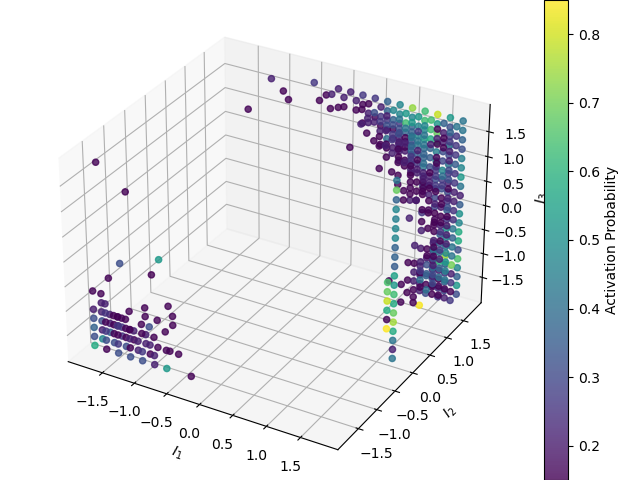

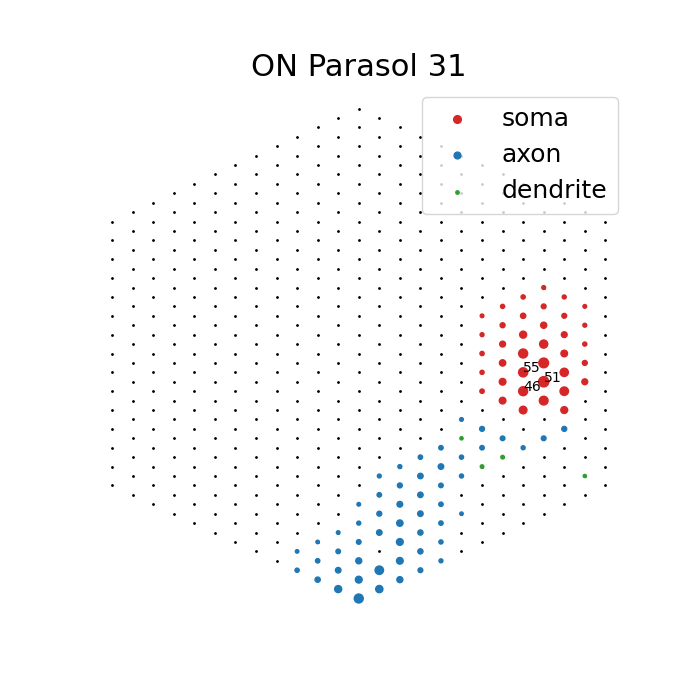

In [4]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_periphery-affinity_cosine"
dataset = "2020-10-18-5"
estim = "data006/data006-all_v2"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 1
n = 31

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/2749728298.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


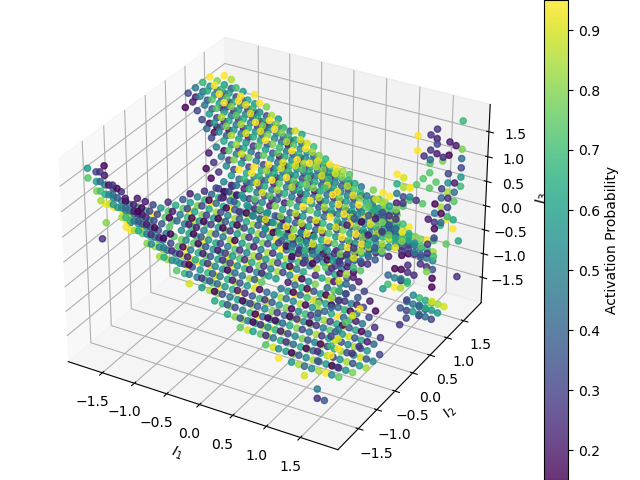

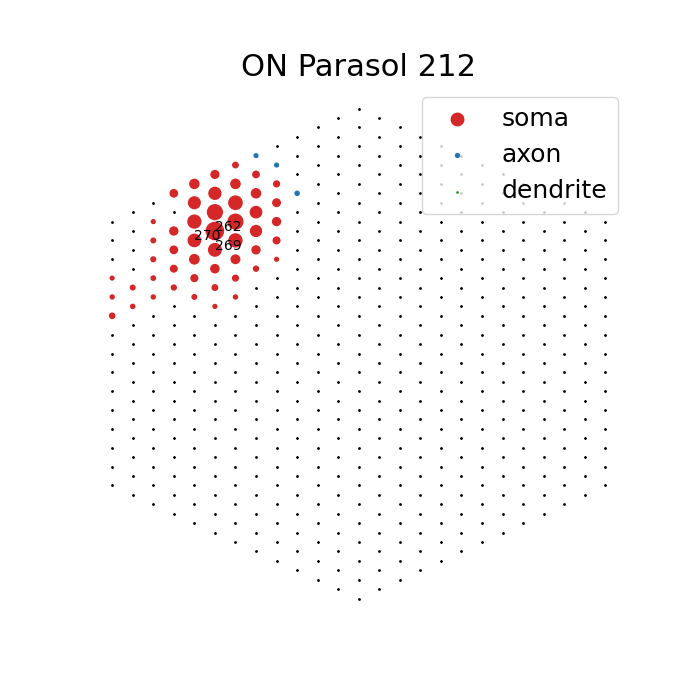

In [5]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_periphery-affinity_cosine"
dataset = "2020-10-18-5"
estim = "data006/data006-all_v2"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 2
n = 212

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/4262694609.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


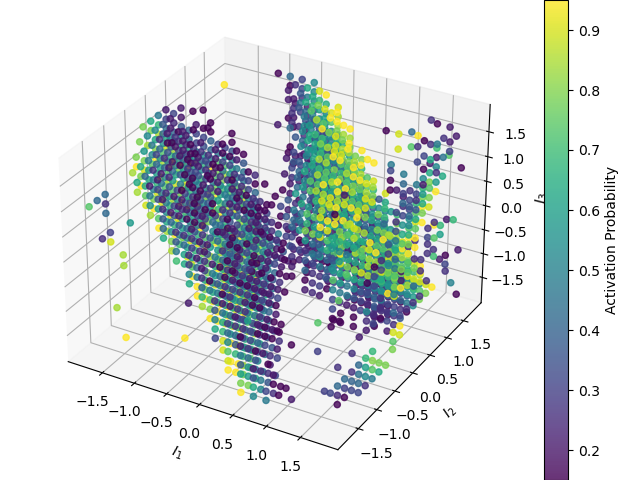

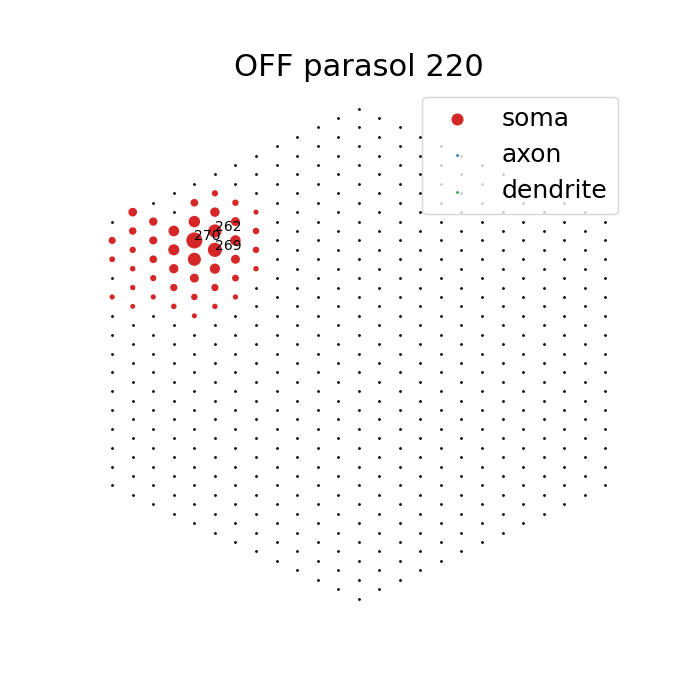

In [6]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_periphery-affinity_cosine"
dataset = "2020-10-18-5"
estim = "data006/data006-all_v2"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 2
n = 220

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/1360712326.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


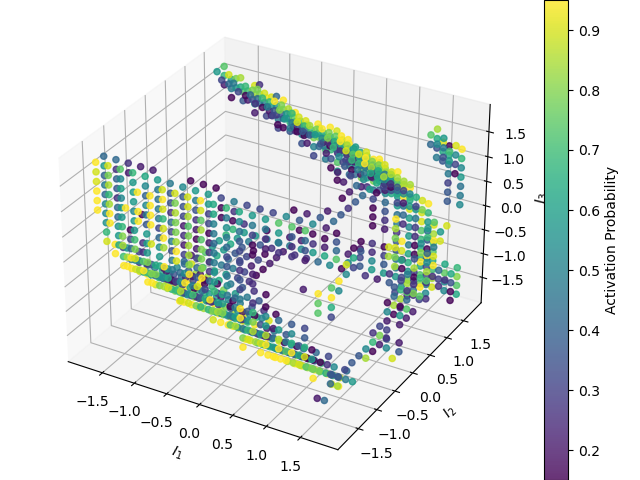

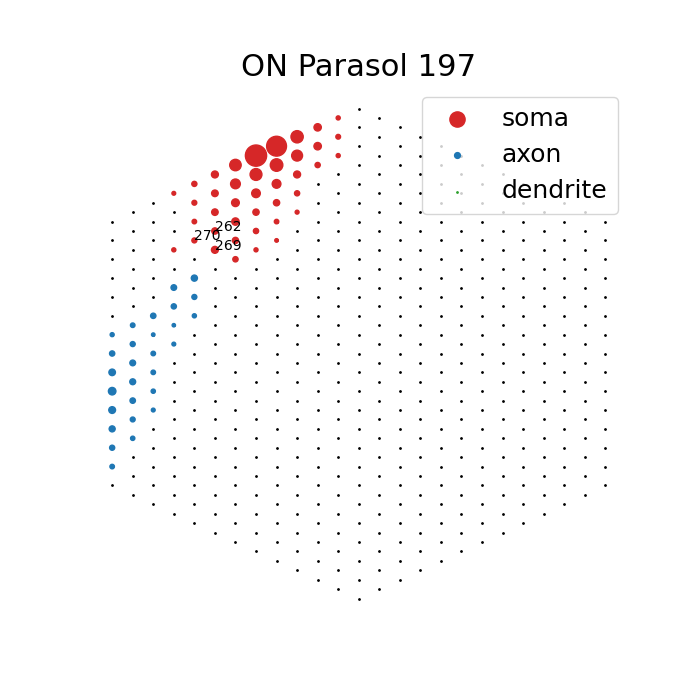

In [7]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_periphery-affinity_cosine"
dataset = "2020-10-18-5"
estim = "data006/data006-all_v2"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 2
n = 197

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

# Raphe

# 2019-06-20-0/data005/data005-all

/tmp/ipykernel_27464/4060451900.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


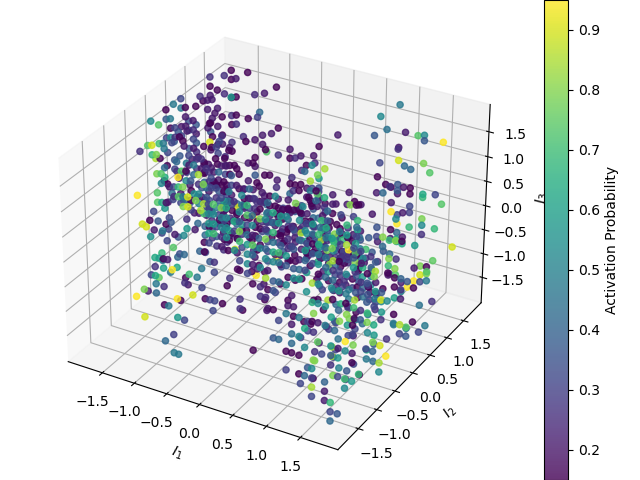

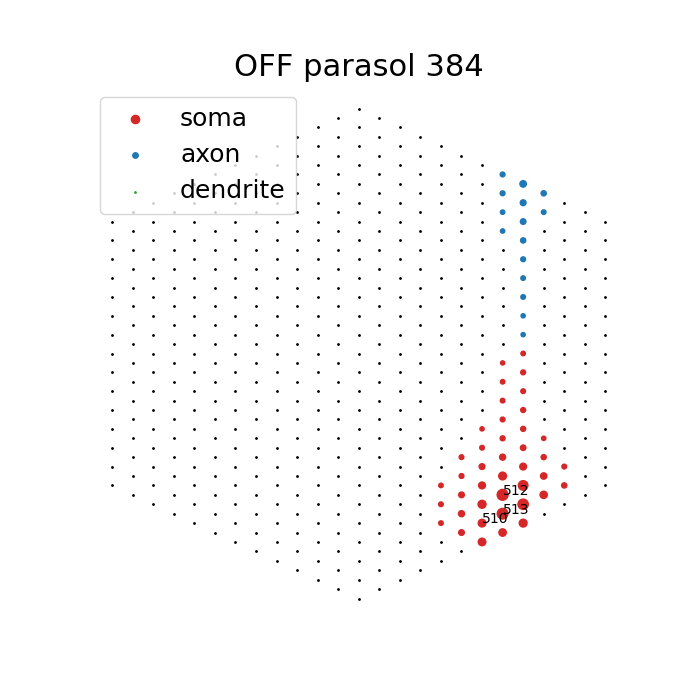

In [8]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data005/data005-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 384

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/1669454772.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


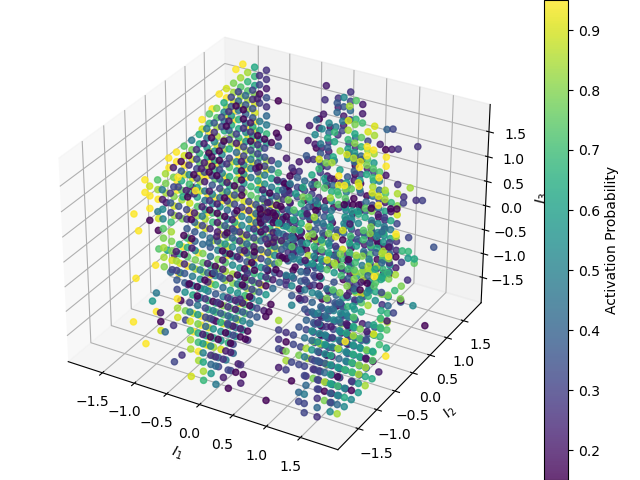

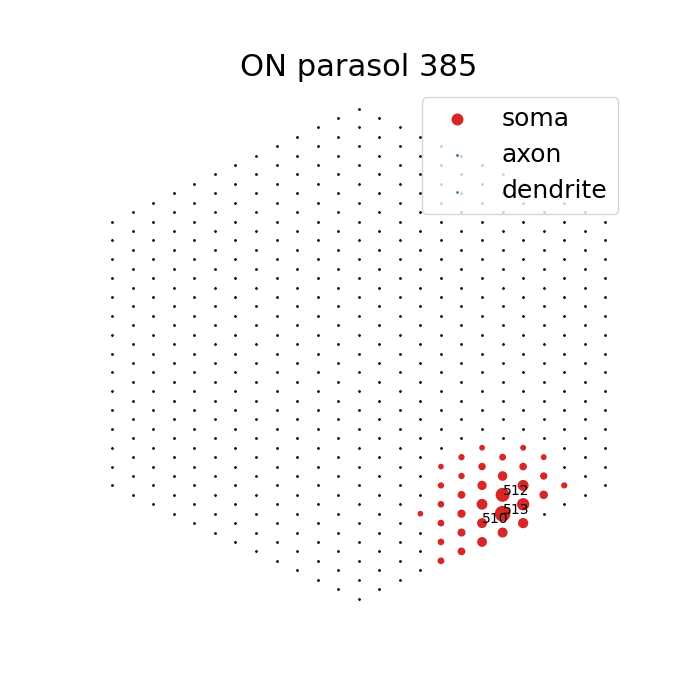

In [9]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data005/data005-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 385

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/3940200089.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


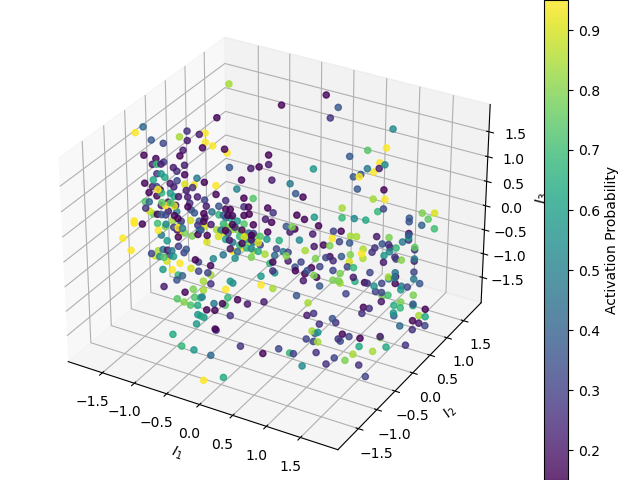

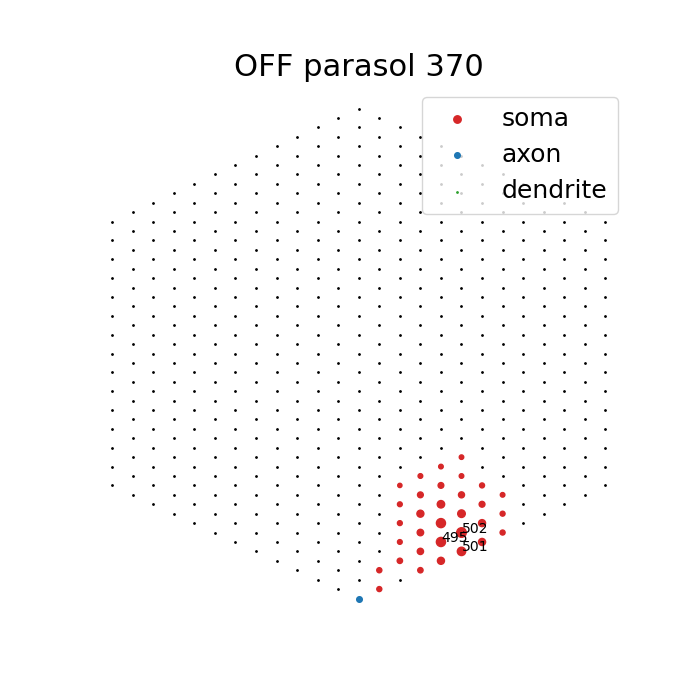

In [10]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data005/data005-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 370

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/471716942.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


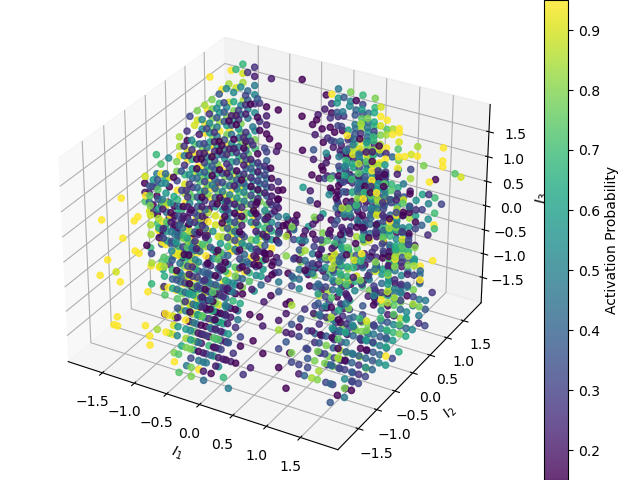

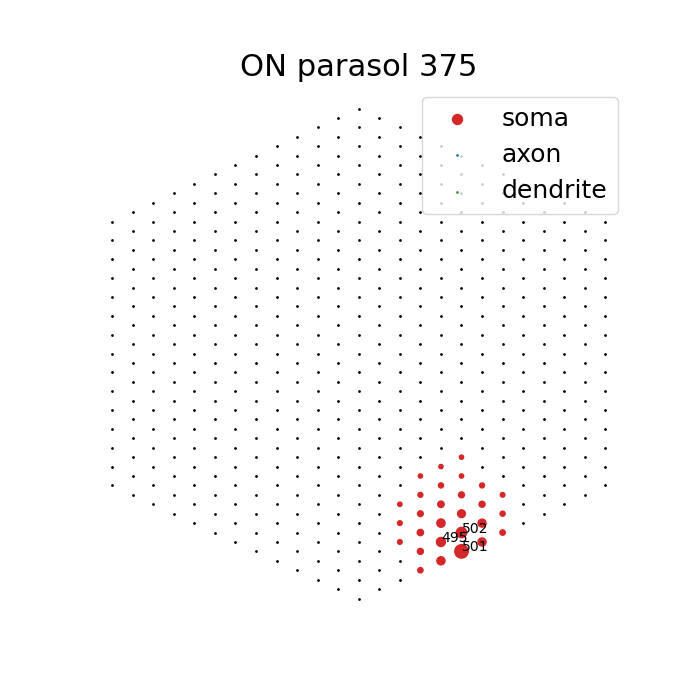

In [11]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data005/data005-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 375

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/4107341103.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


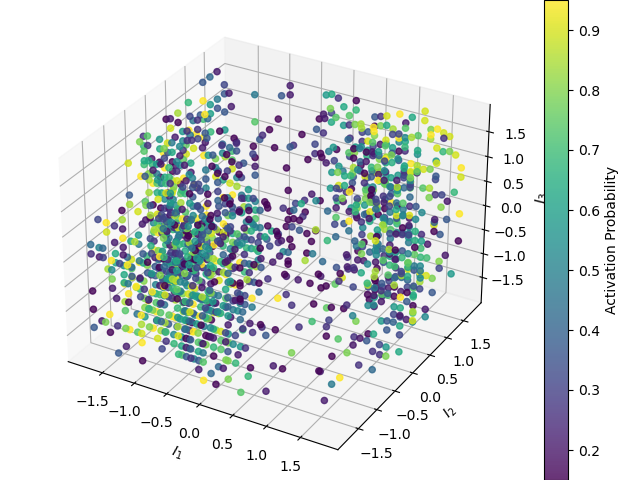

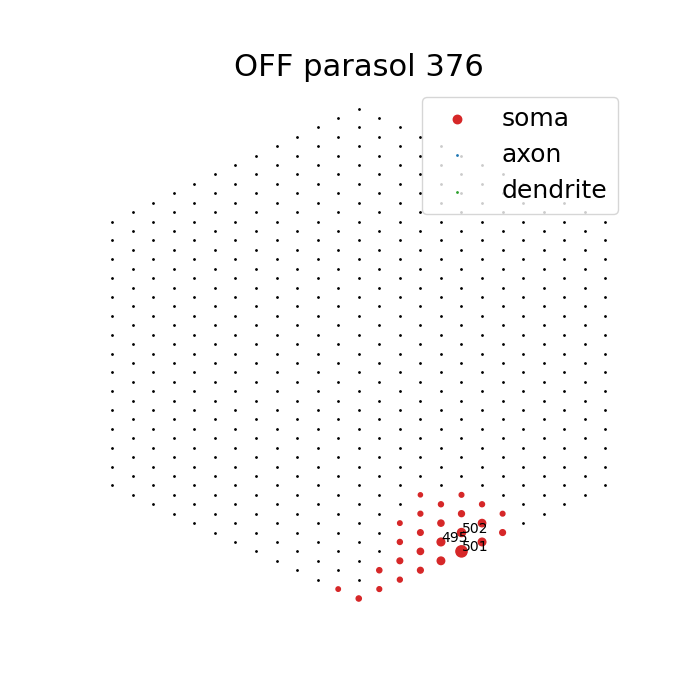

In [12]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data005/data005-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 376

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/2436250198.py:42: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/tmp/ipykernel_27464/2436250198.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


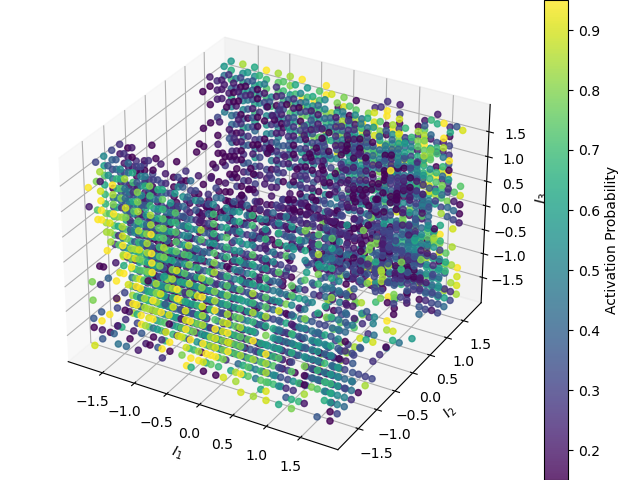

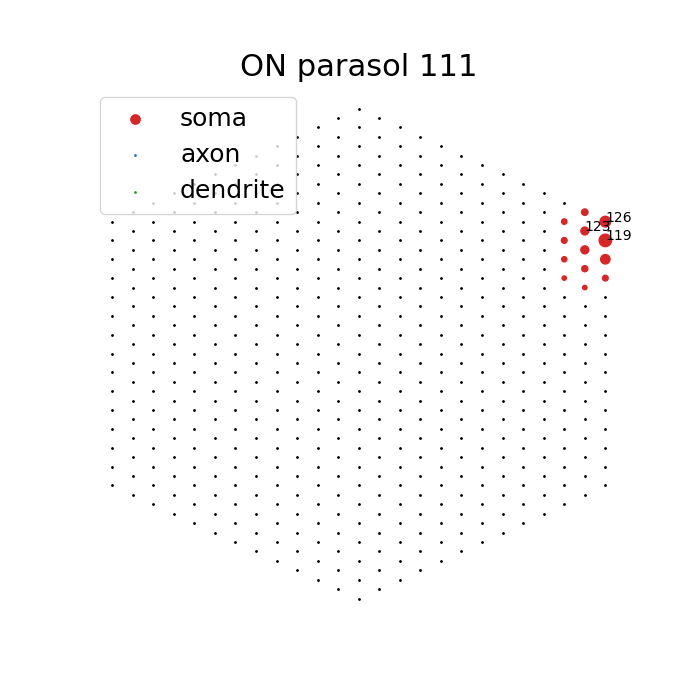

In [13]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data005/data005-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 3
n = 111

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/3376298403.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


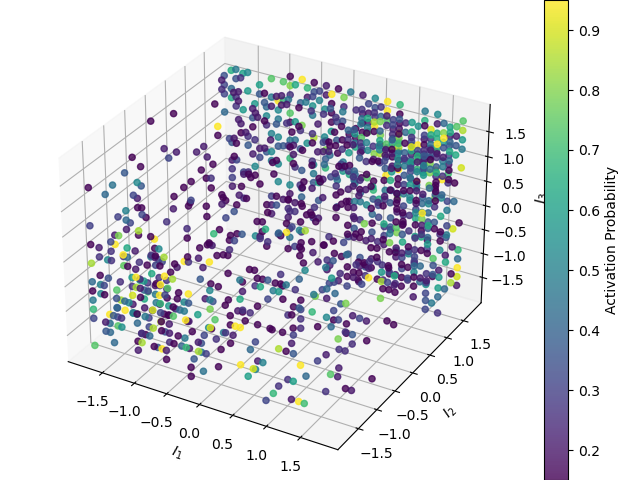

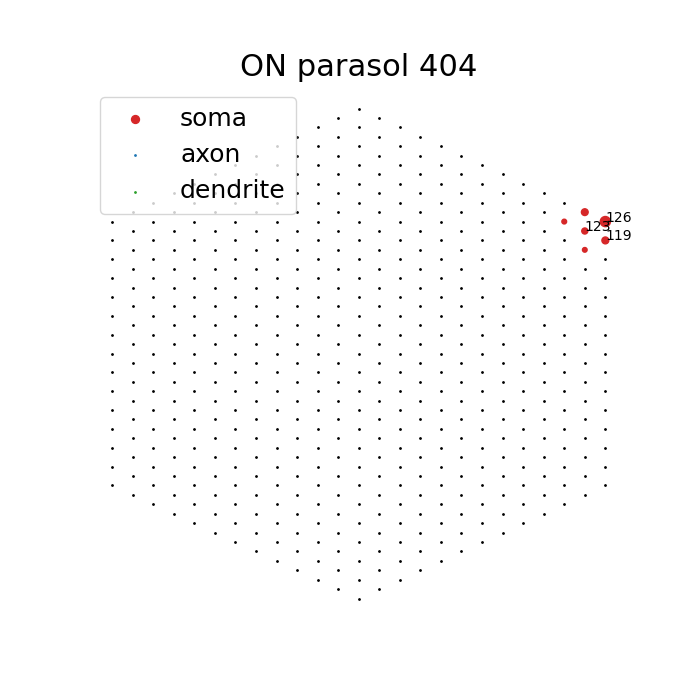

In [14]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data005/data005-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 3
n = 404

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

# 2019-06-20-0/data006/data006-all

/tmp/ipykernel_27464/1197090114.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


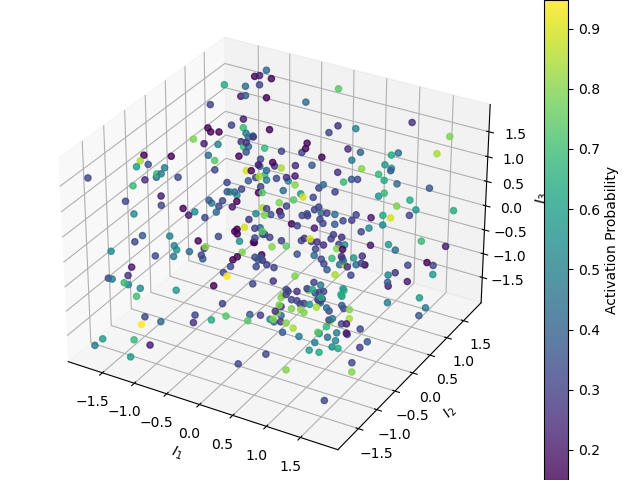

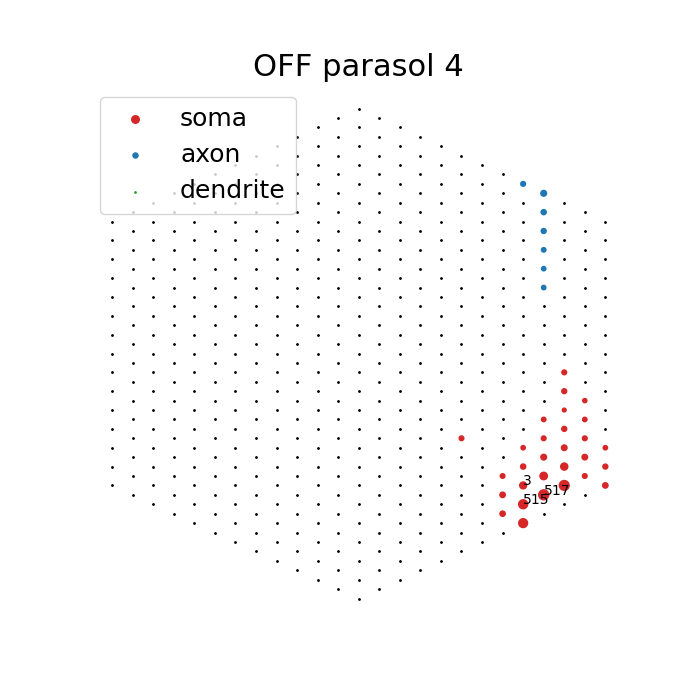

In [15]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 4

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/2187105636.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


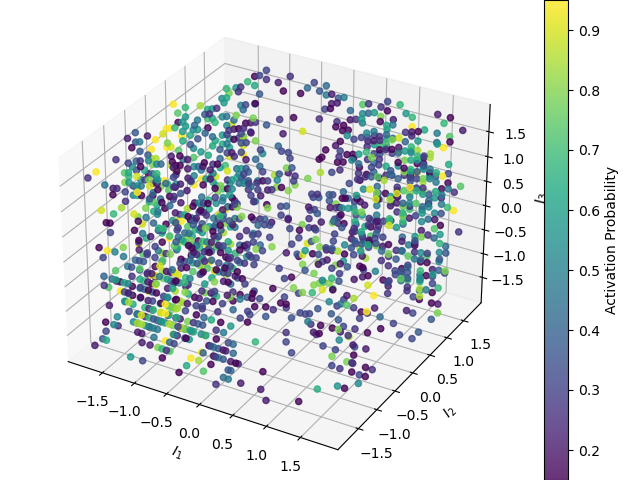

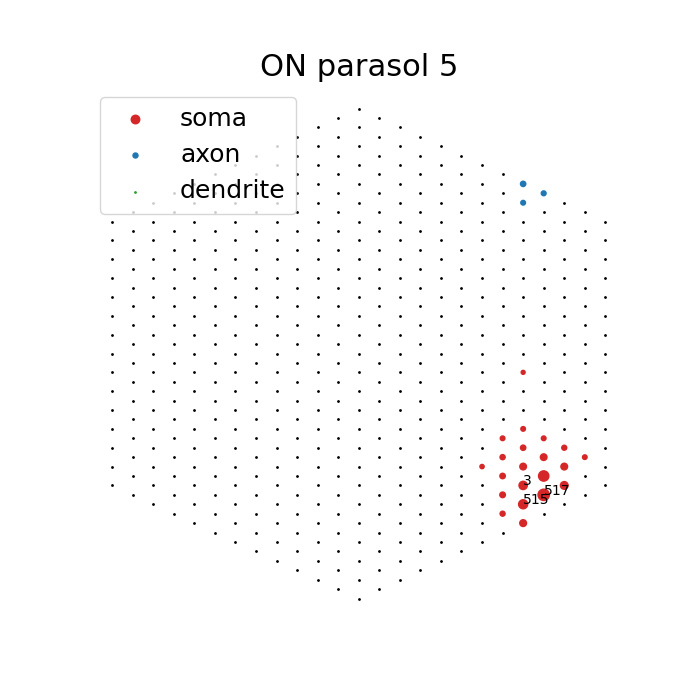

In [16]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 5

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/158738732.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


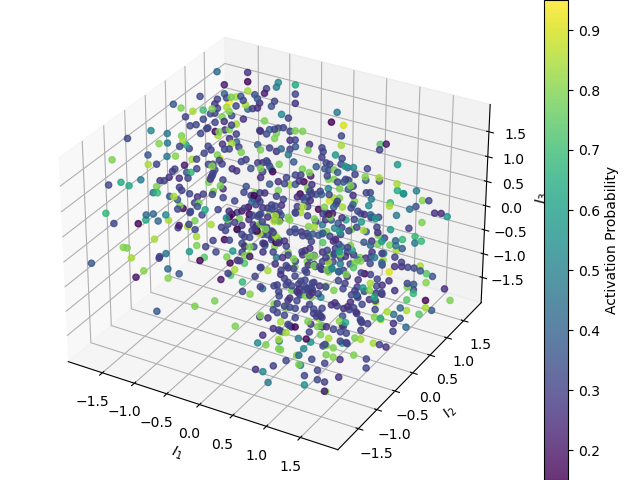

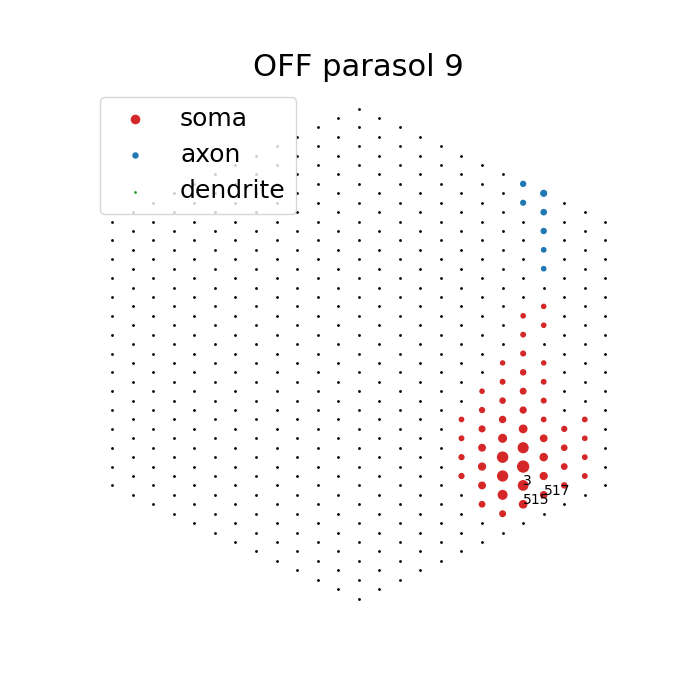

In [17]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 9

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/3735418451.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


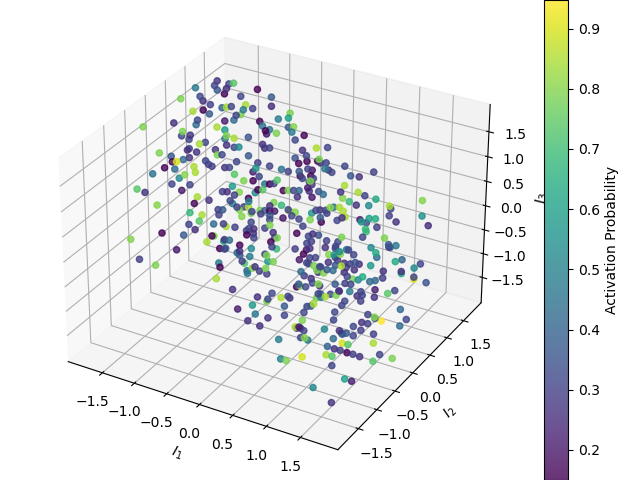

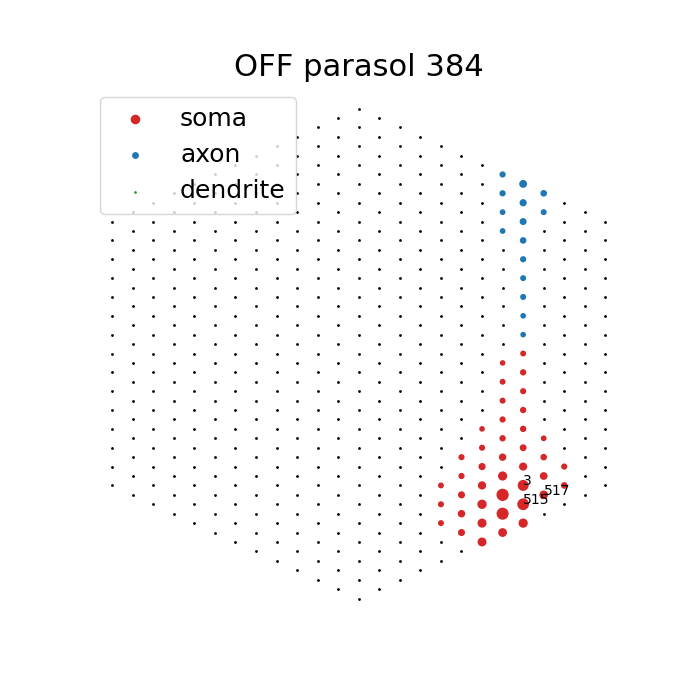

In [18]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 384

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/2368065033.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


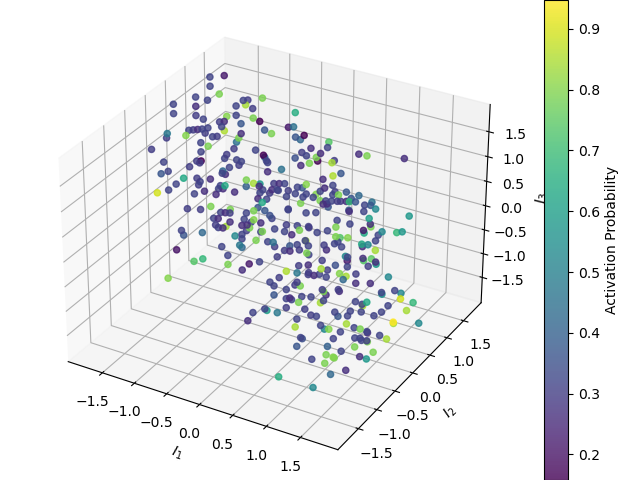

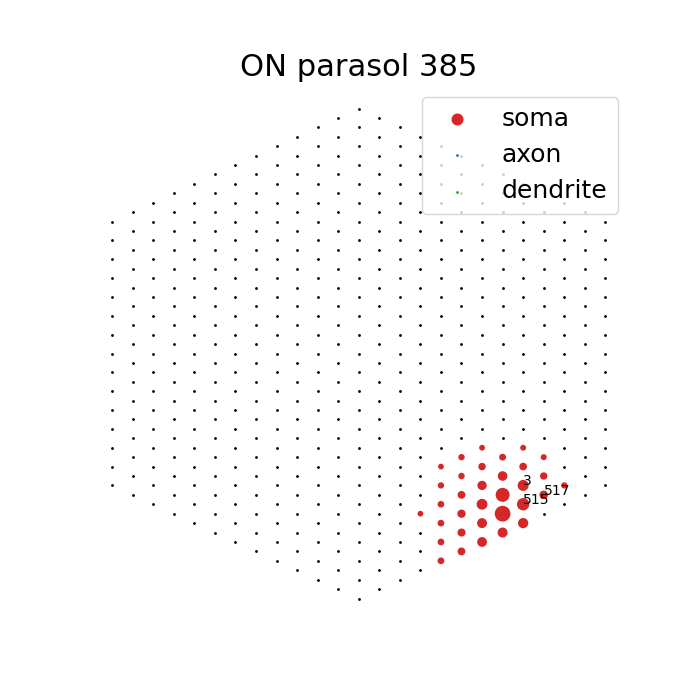

In [19]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 385

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/1792884918.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


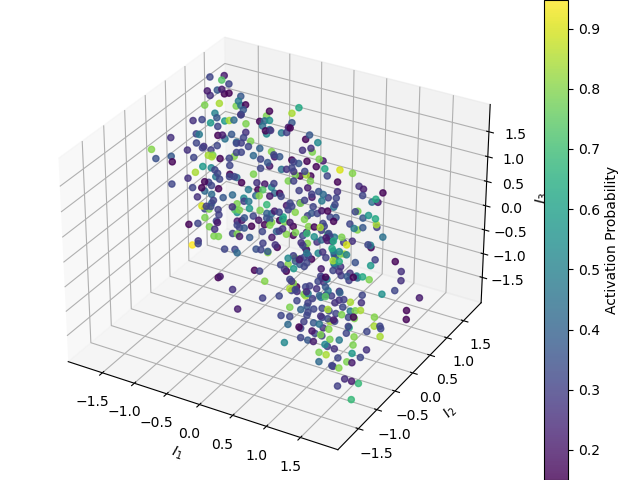

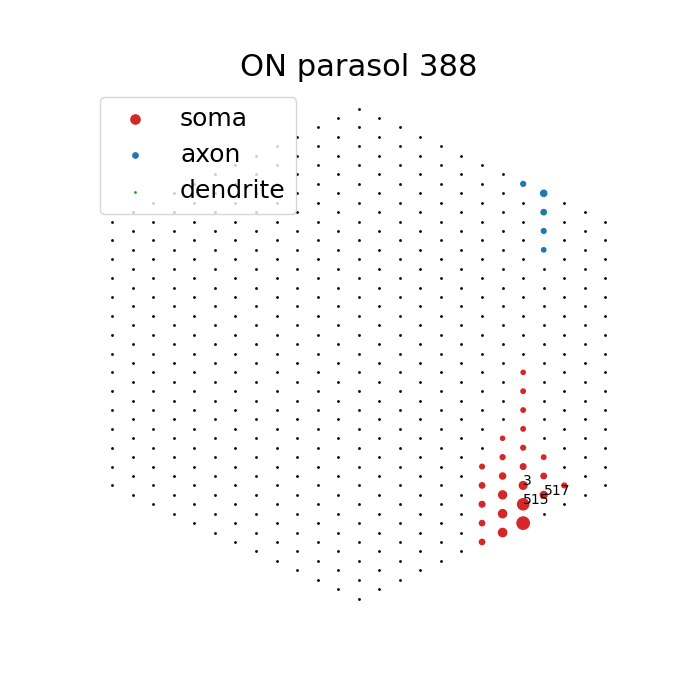

In [20]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 388

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/3022188183.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


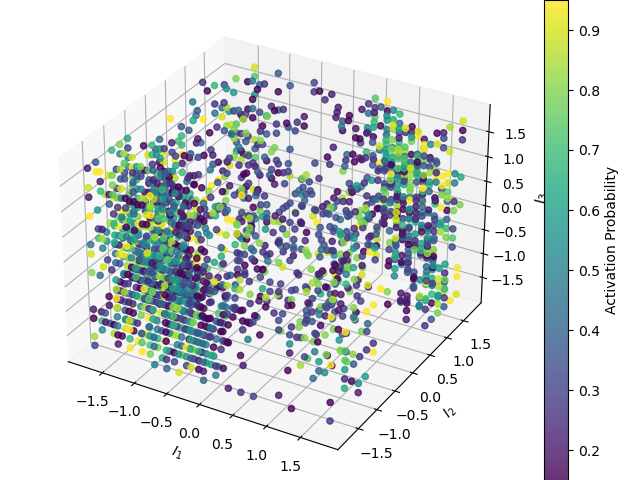

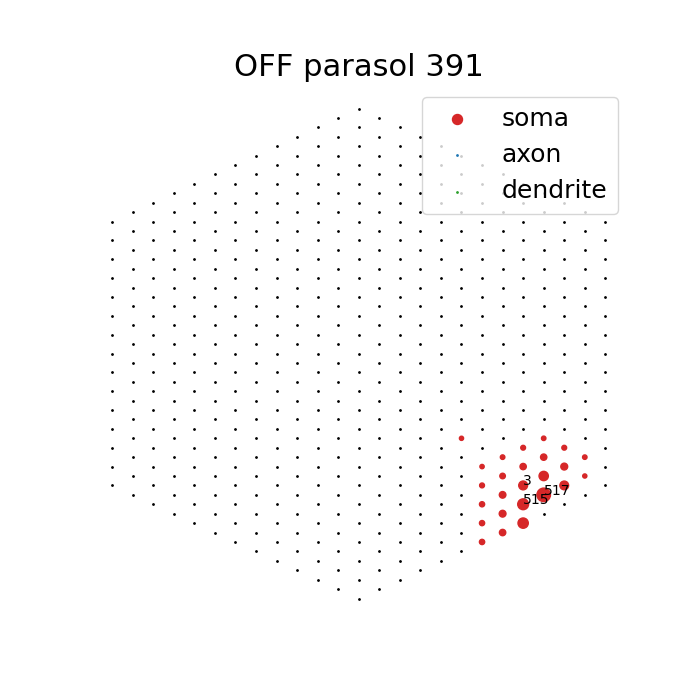

In [21]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 391

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/2636069177.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


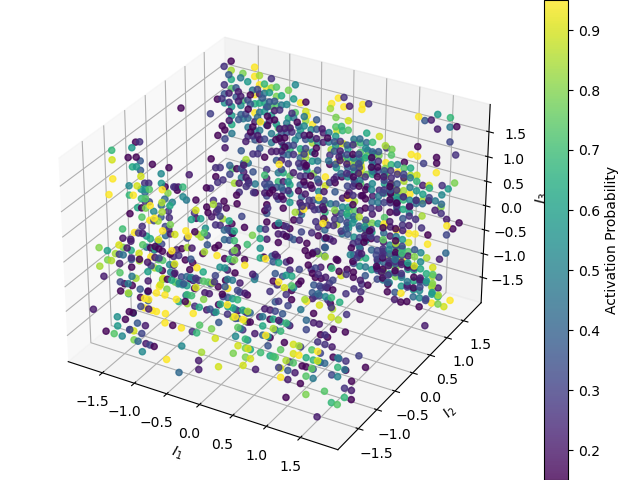

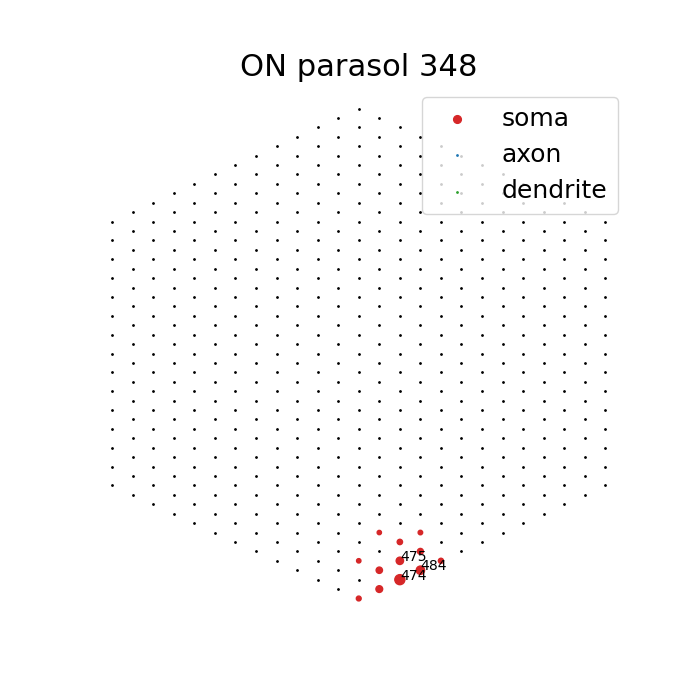

In [22]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 348

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/410570742.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


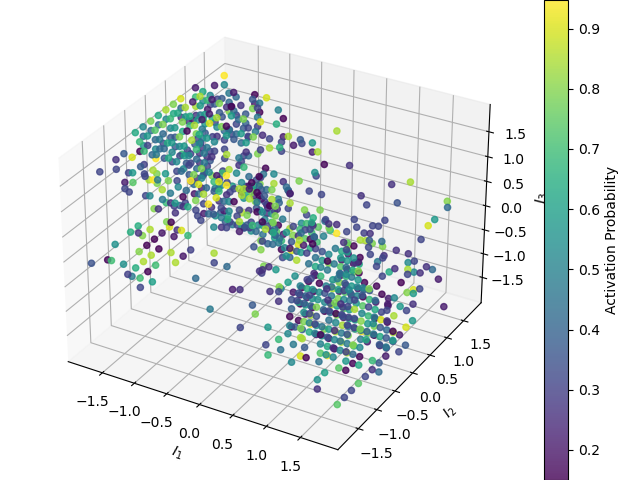

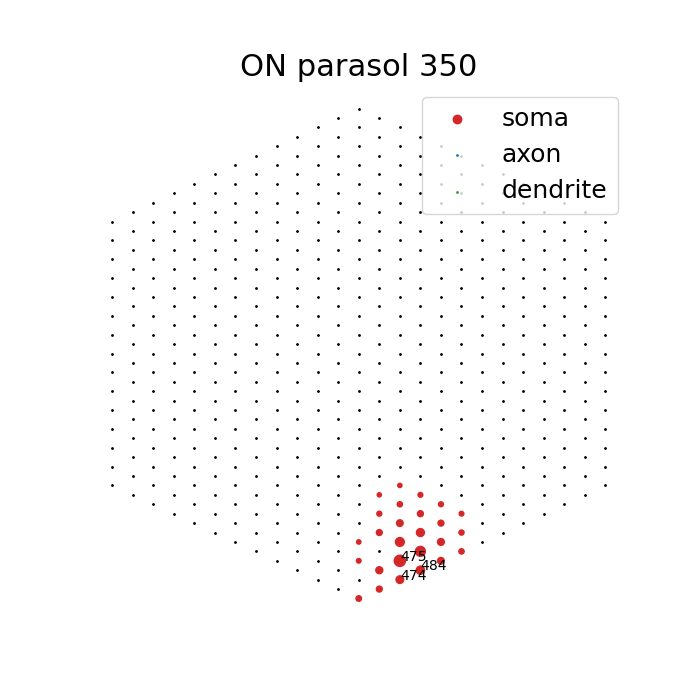

In [23]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 350

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/464923481.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


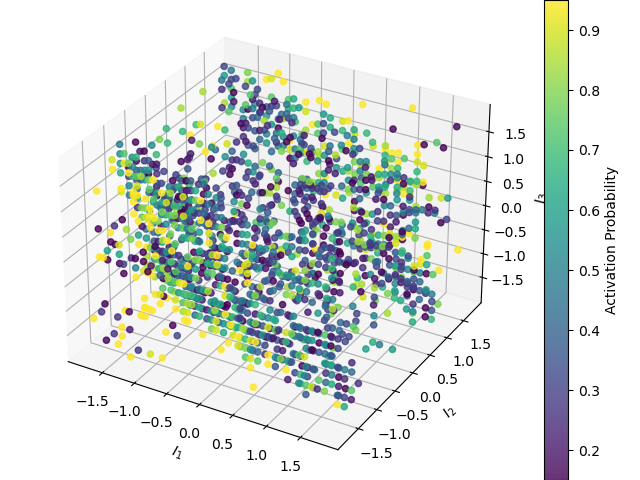

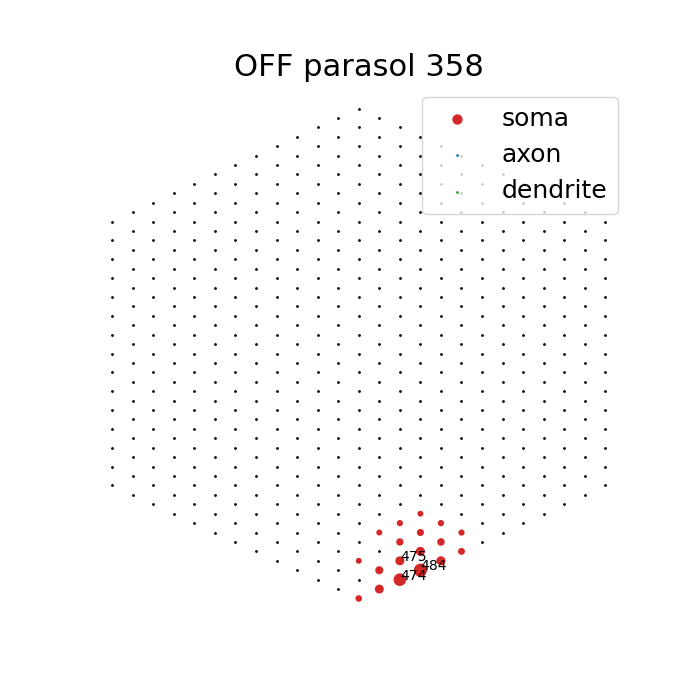

In [24]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 358

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/2463106162.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


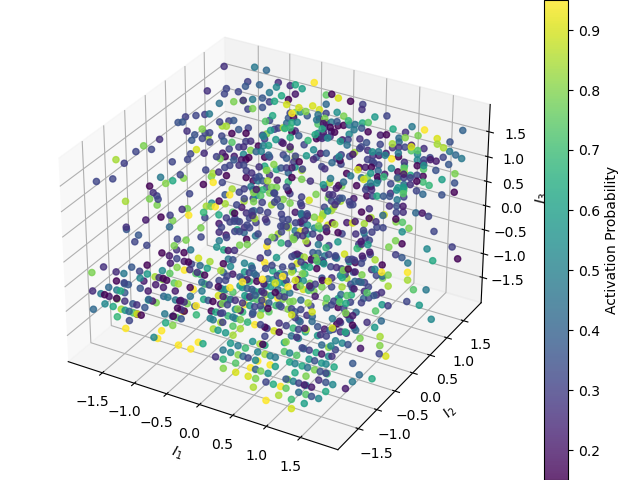

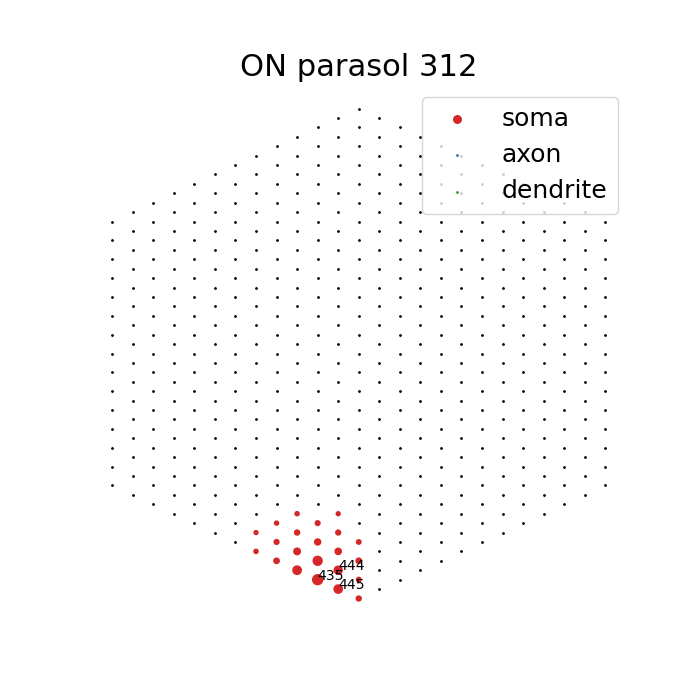

In [25]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 3
n = 312

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/2724966042.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


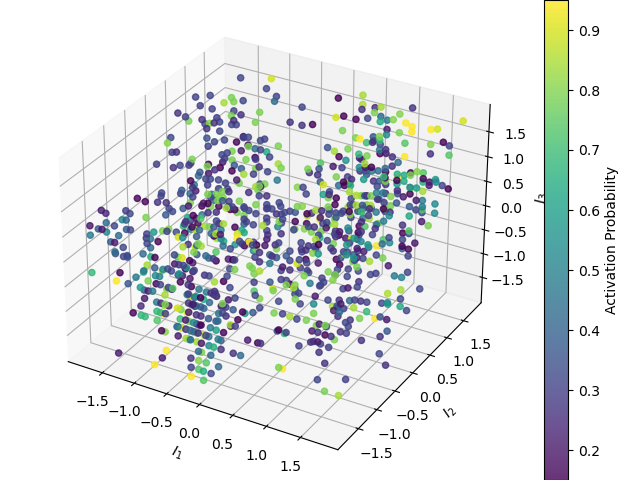

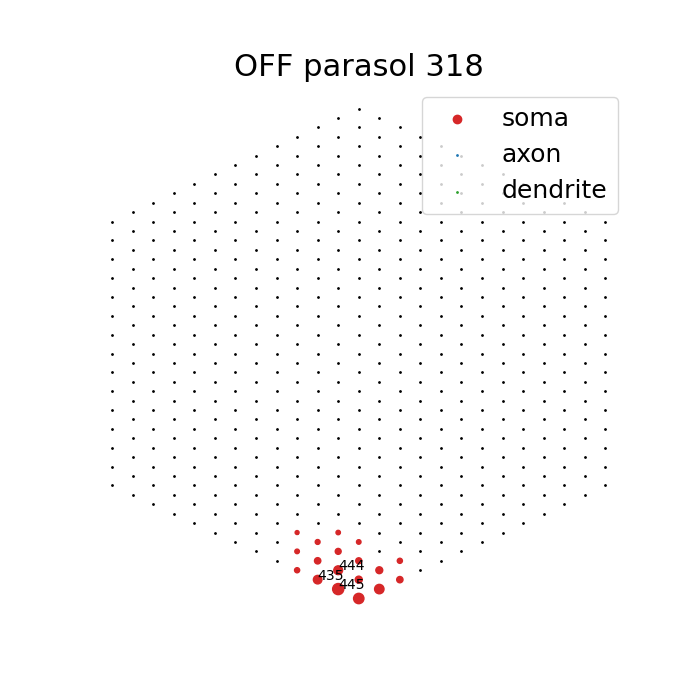

In [26]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 3
n = 318

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/614287410.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


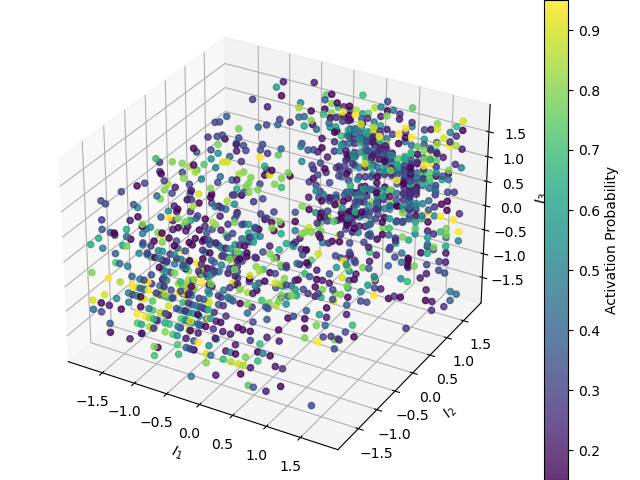

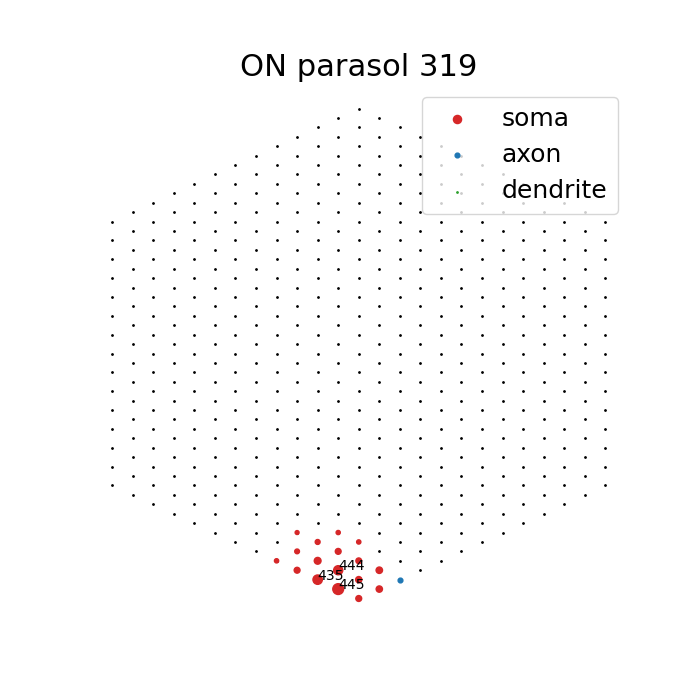

In [27]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data006/data006-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 3
n = 319

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

# 2019-06-20-0/data008/data008-all

/tmp/ipykernel_27464/116612704.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


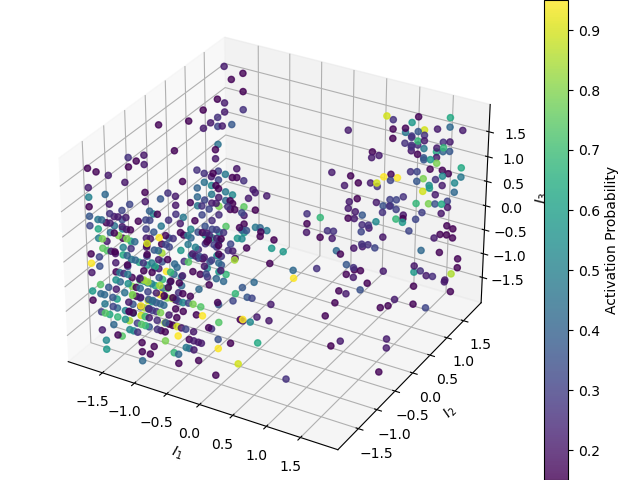

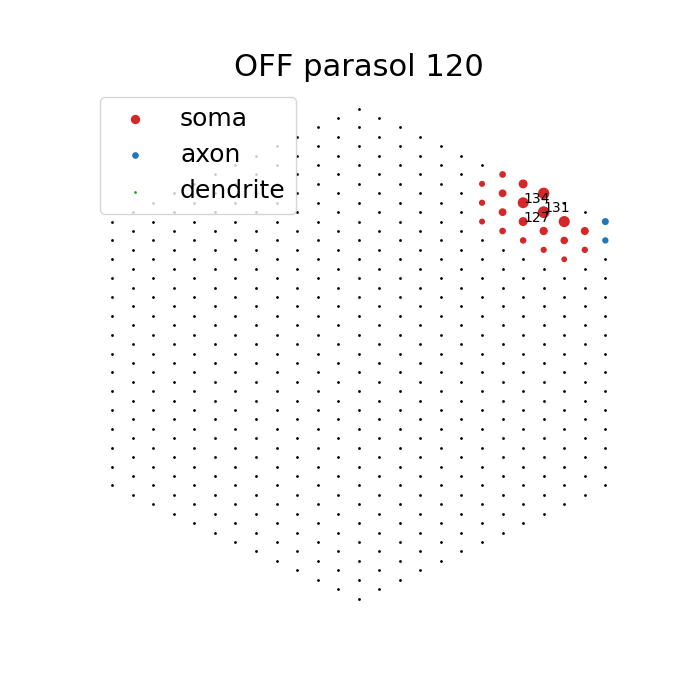

In [28]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data008/data008-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 120

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/4029557369.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


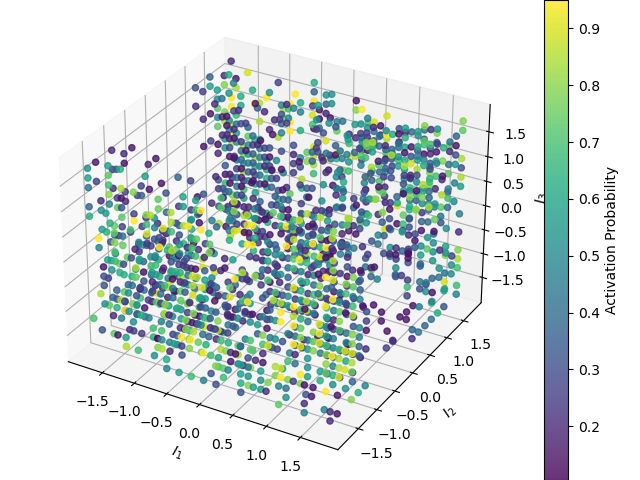

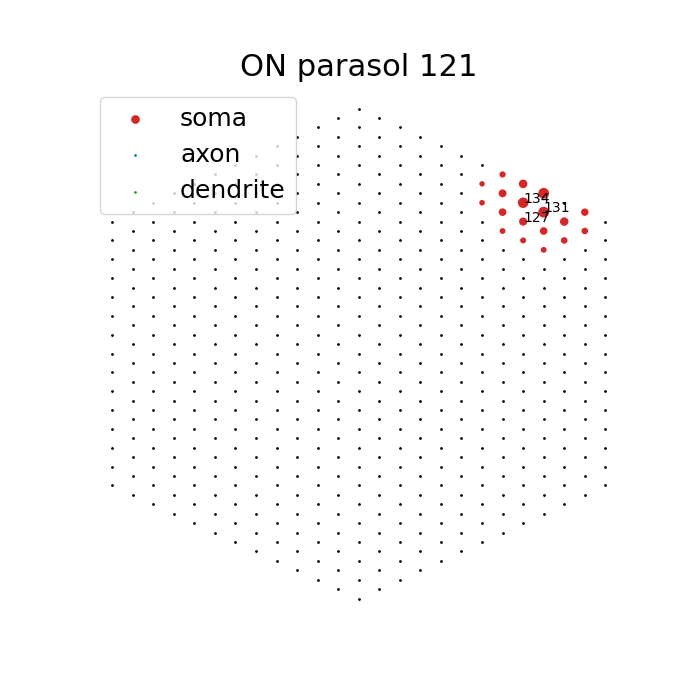

In [29]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data008/data008-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 121

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/1327133492.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


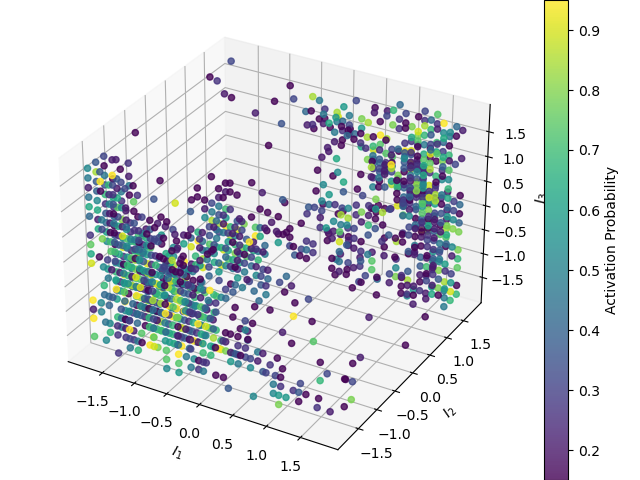

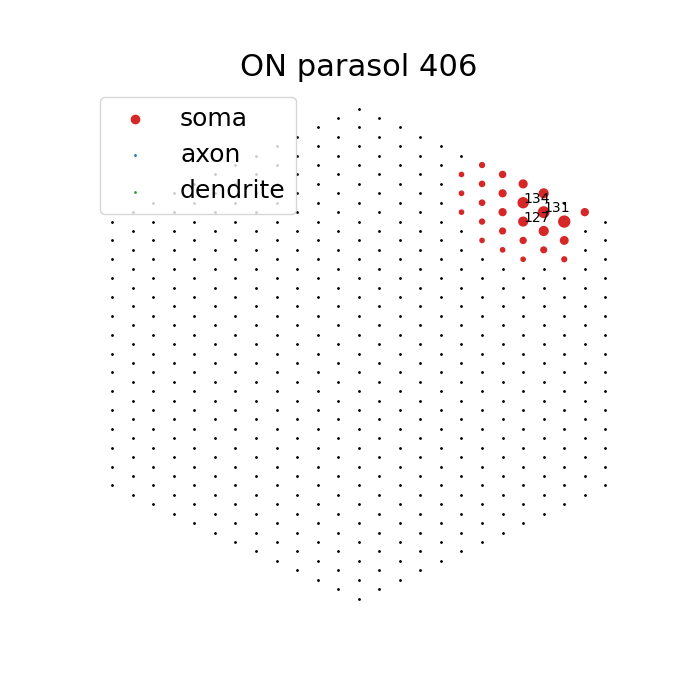

In [30]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data008/data008-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 406

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/4215026653.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


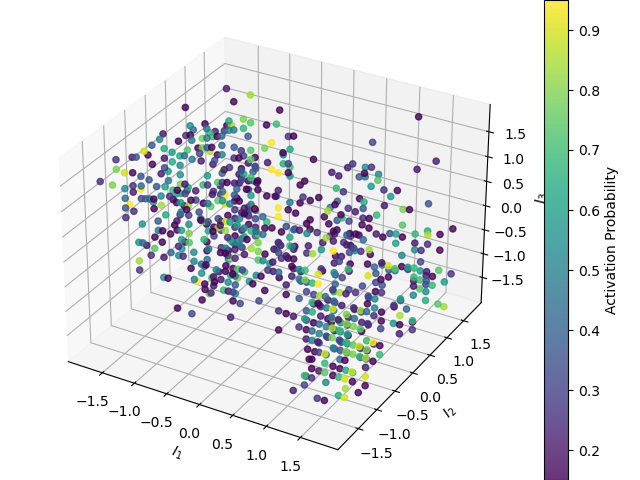

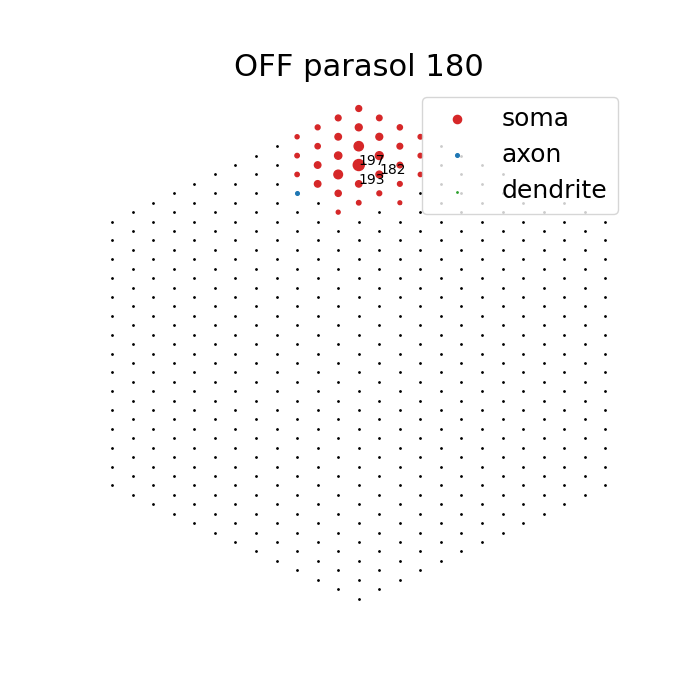

In [31]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data008/data008-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 180

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/3394369701.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


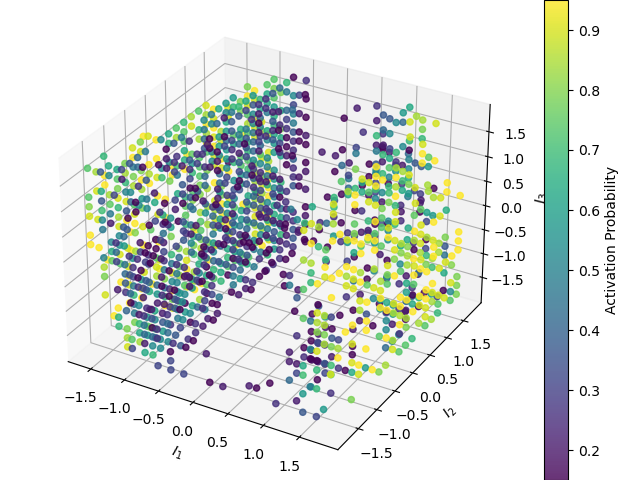

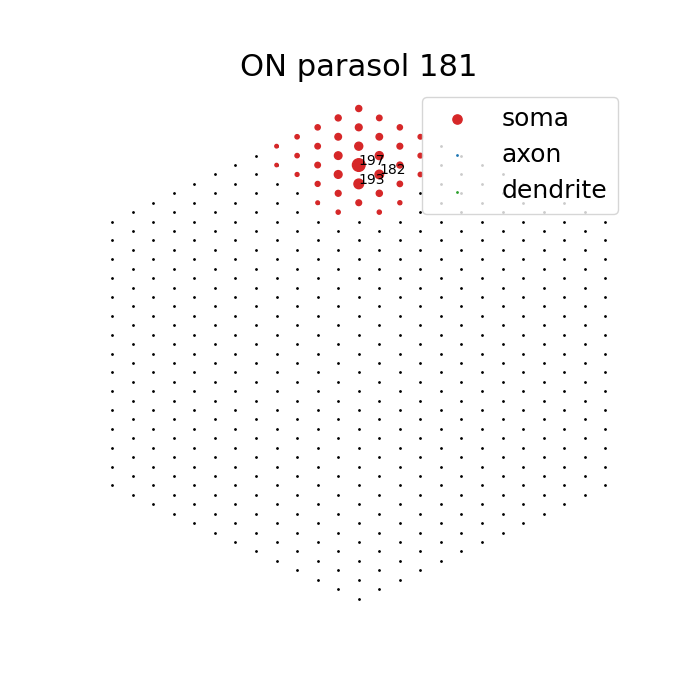

In [32]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data008/data008-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 181

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/3522881809.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


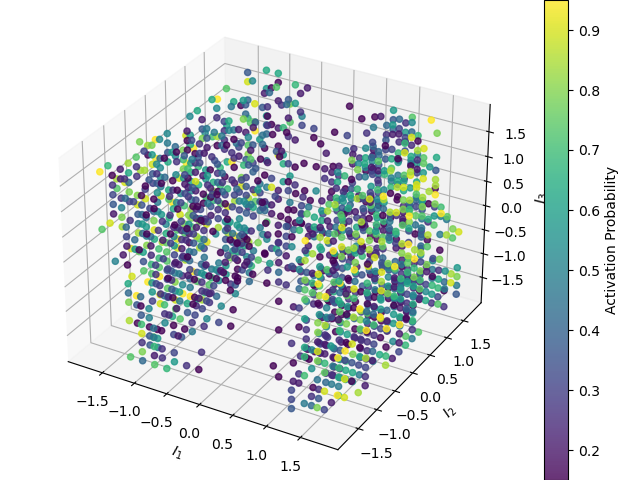

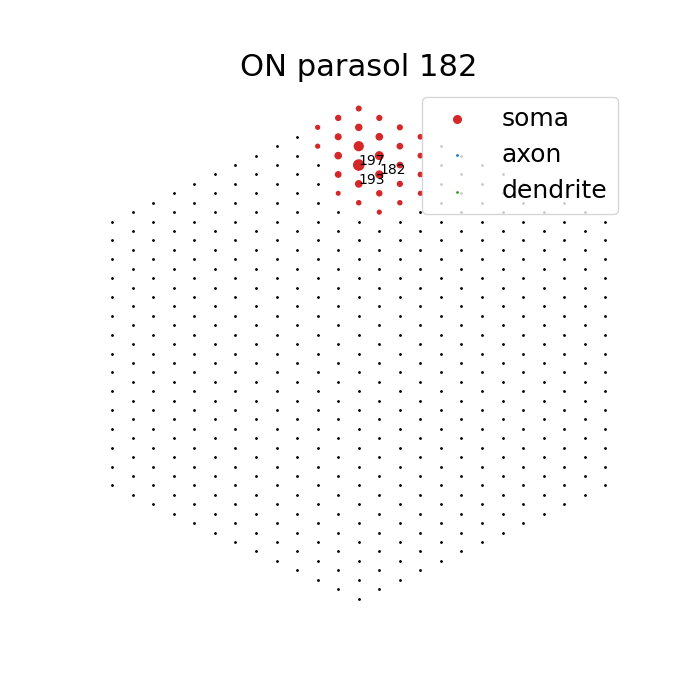

In [33]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data008/data008-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 182

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/355013131.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


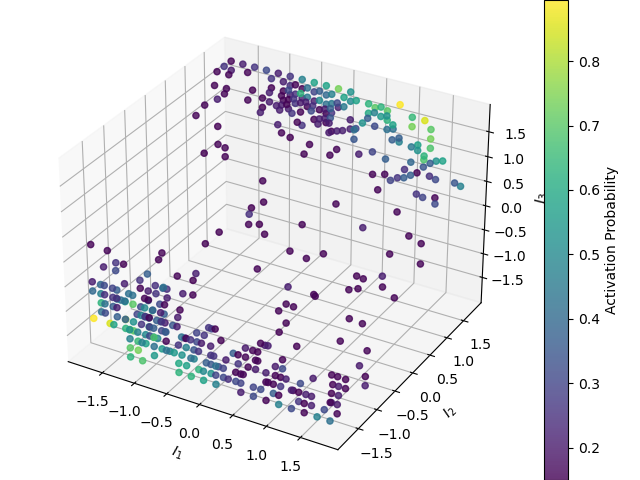

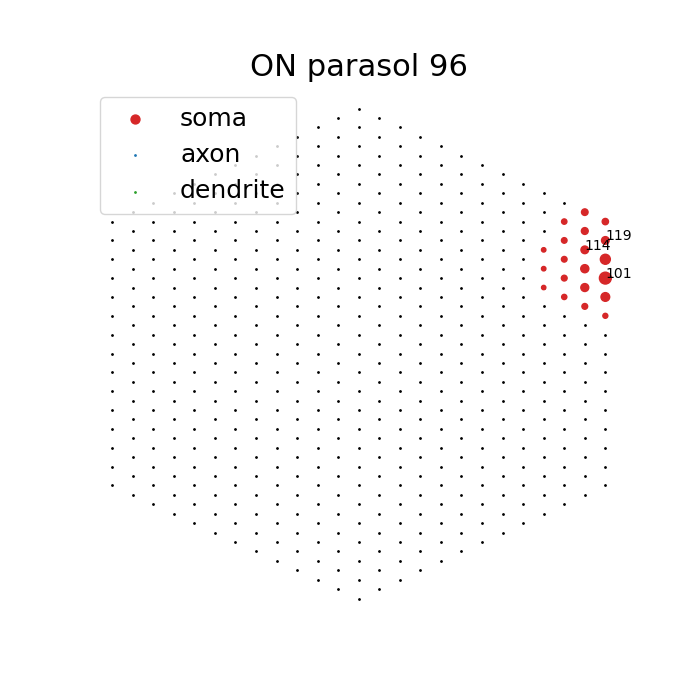

In [34]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2019-06-20-0"
estim = "data008/data008-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 3
n = 96

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

# 2020-09-29-2/data007/data007-all

/tmp/ipykernel_27464/3889174808.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


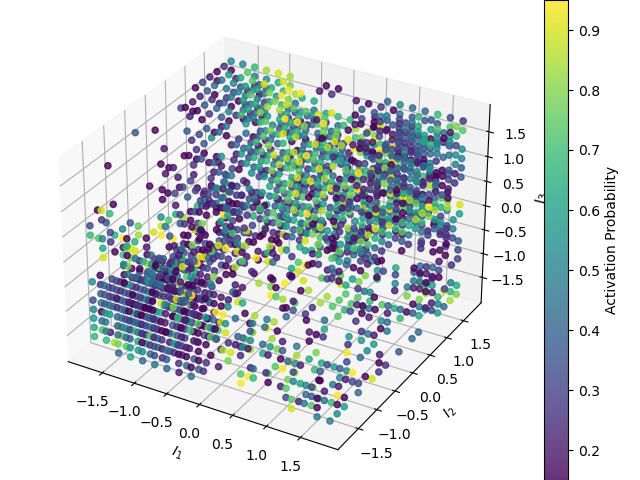

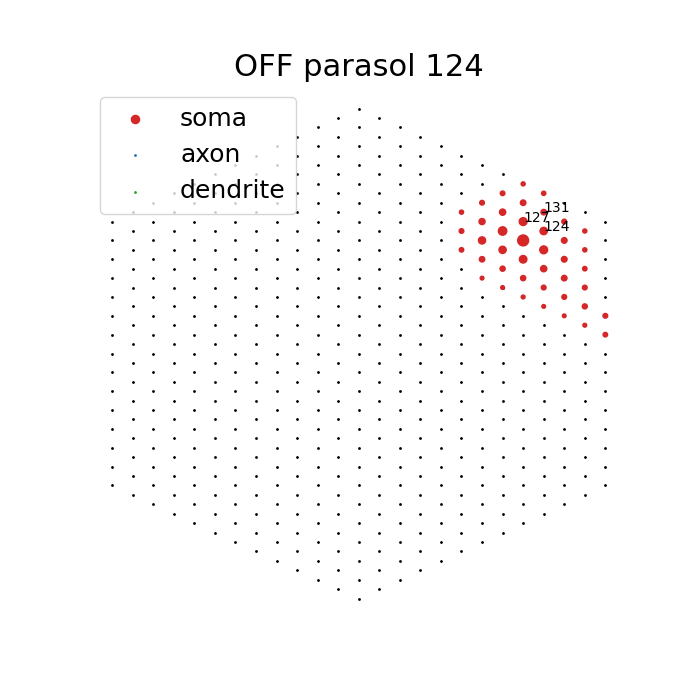

In [35]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data007/data007-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 1
n = 124

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/629494777.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


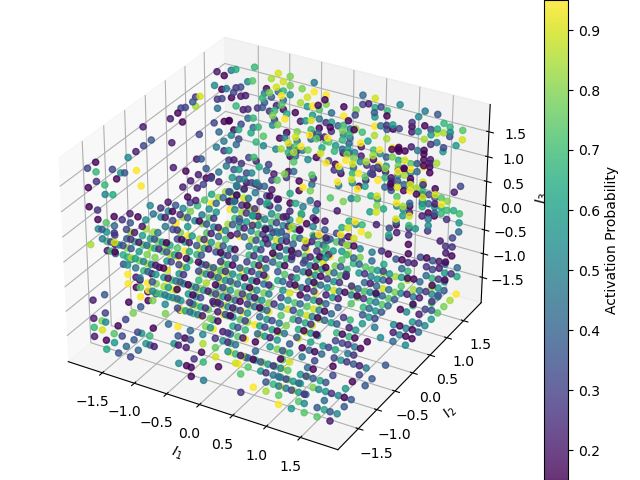

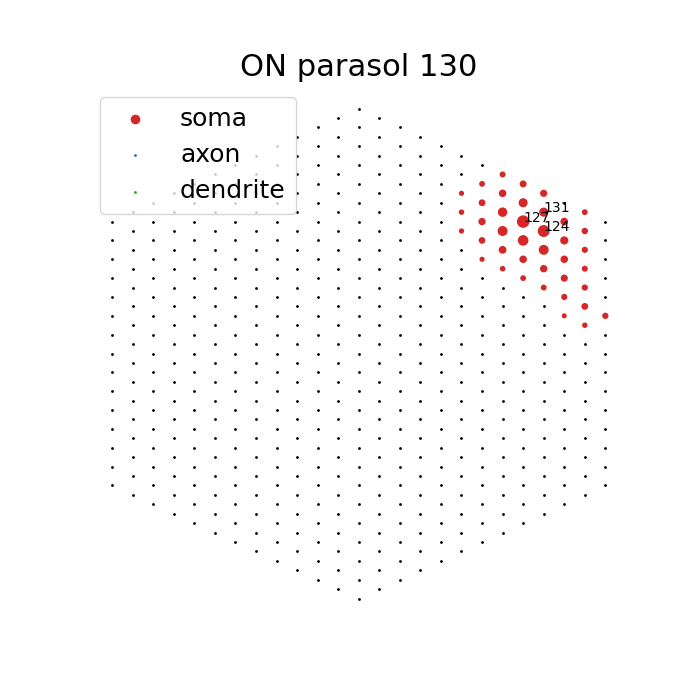

In [36]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data007/data007-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 1
n = 130

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/3165863677.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


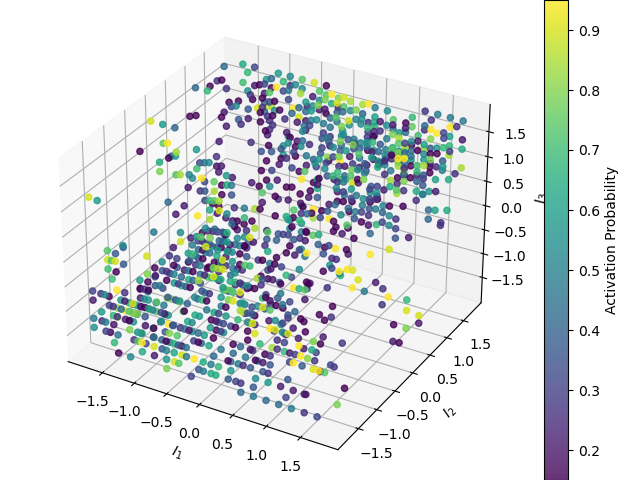

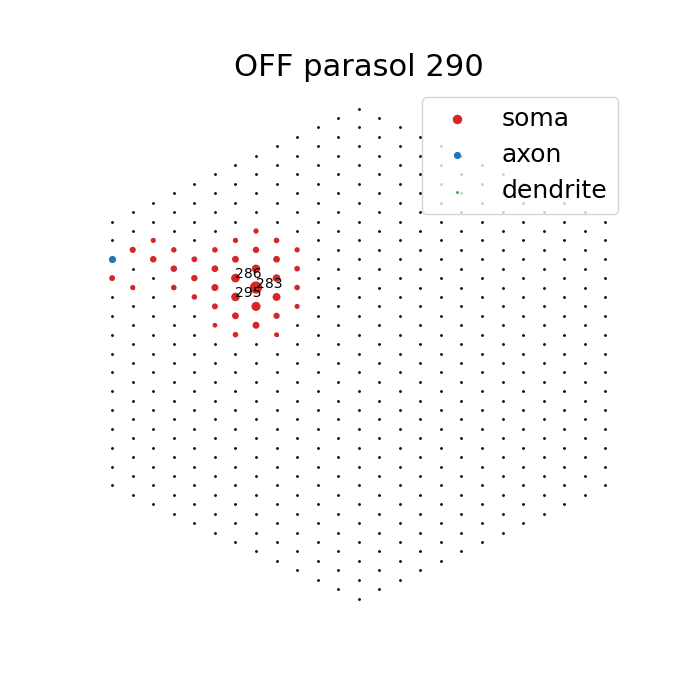

In [37]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data007/data007-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 2
n = 290

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/2243266491.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


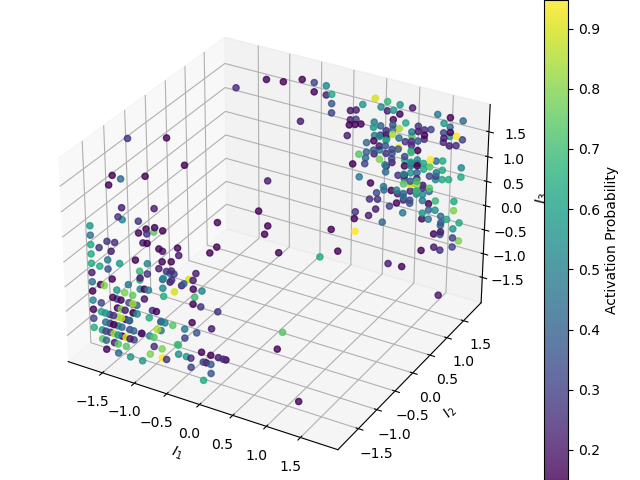

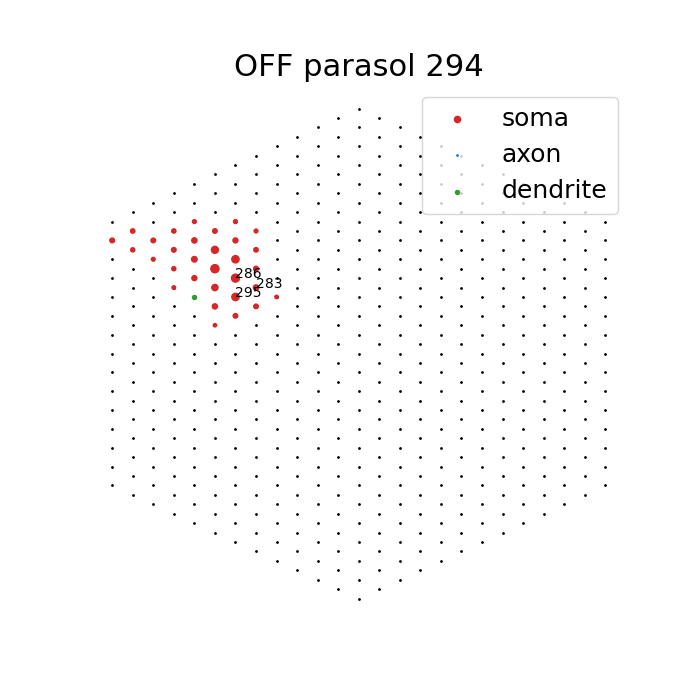

In [38]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data007/data007-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 2
n = 294

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/2420025504.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


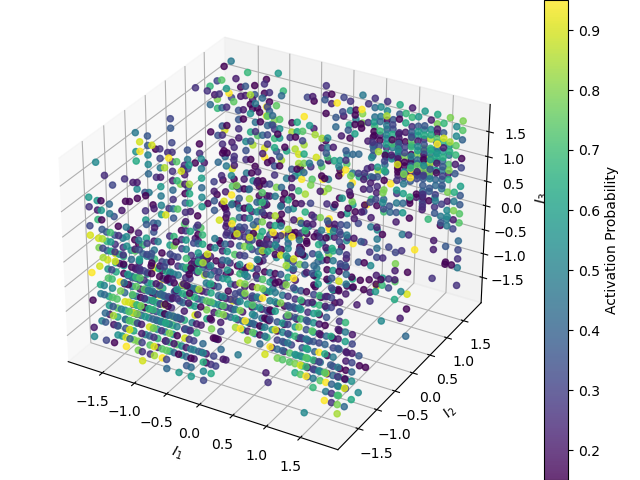

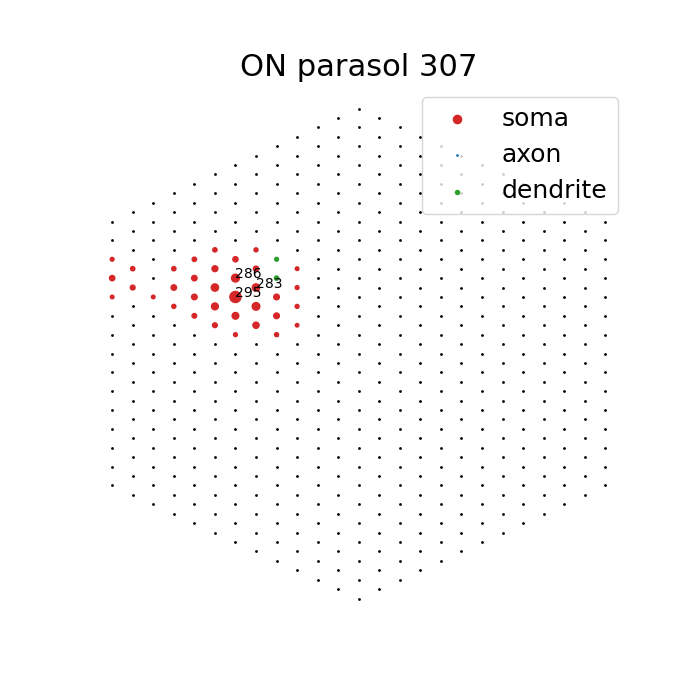

In [39]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data007/data007-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 2
n = 307

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

/tmp/ipykernel_27464/1506994480.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


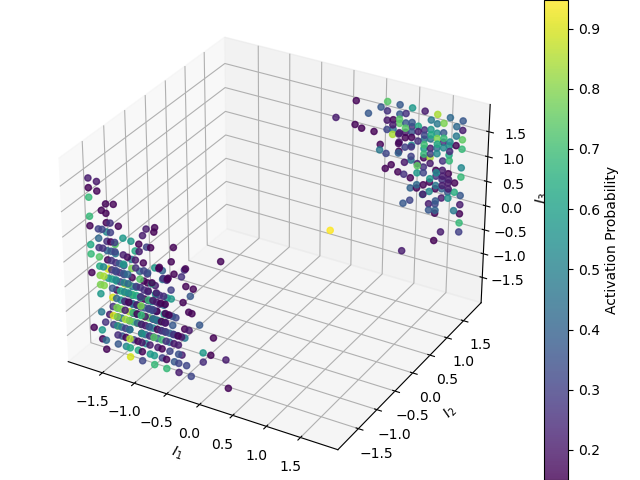

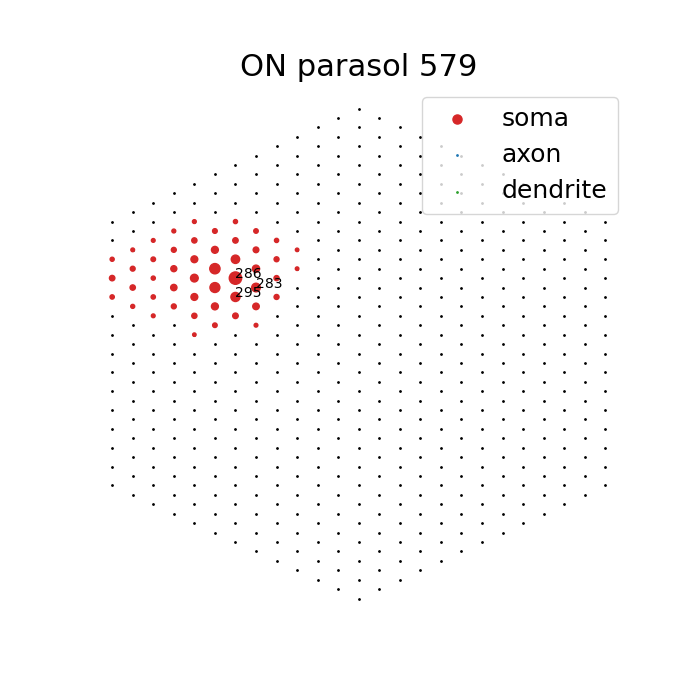

In [40]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data007/data007-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 2
n = 579

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="best")
plt.show()

# 2020-09-29-2/data008/data008-all

/tmp/ipykernel_27464/4093188644.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


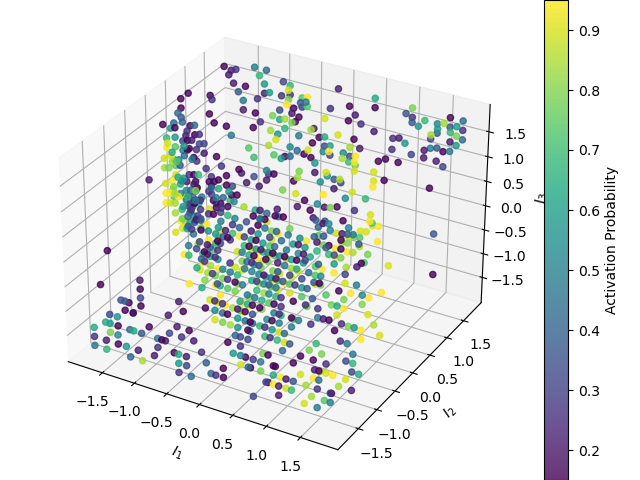

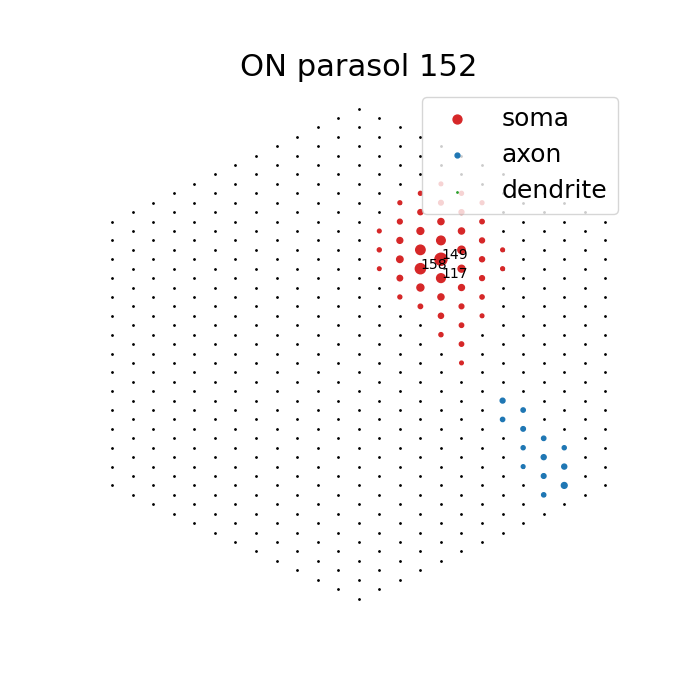

In [41]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data008/data008-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 1
n = 152

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/3462806657.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


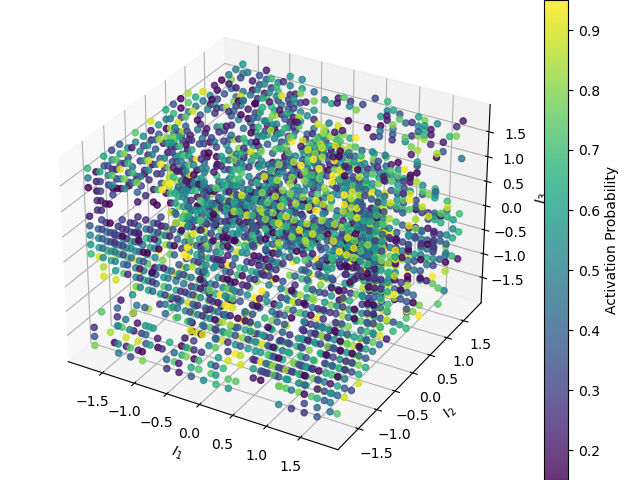

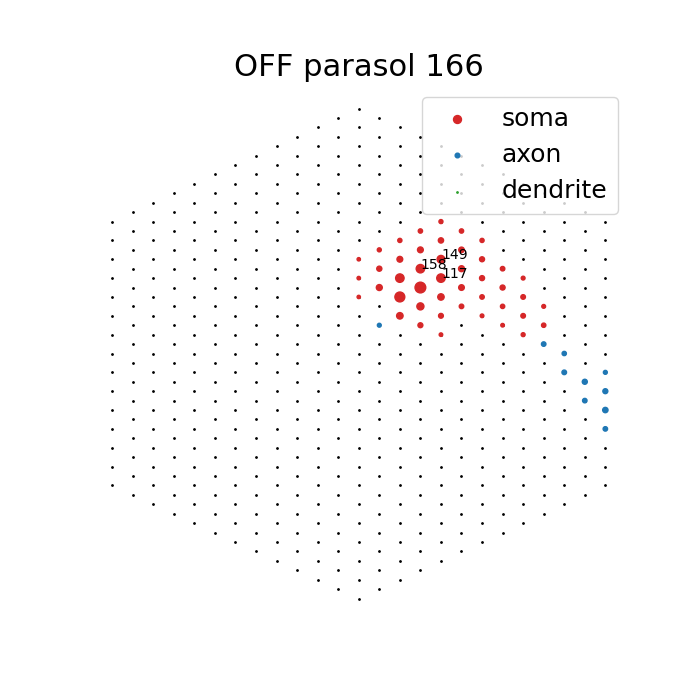

In [42]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data008/data008-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 1
n = 166

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/4246995336.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


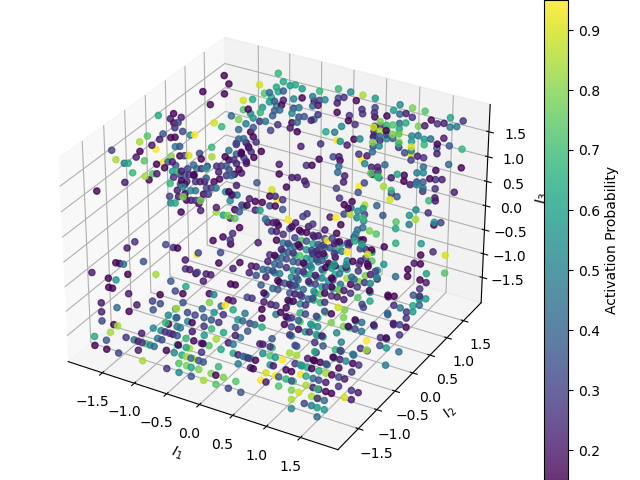

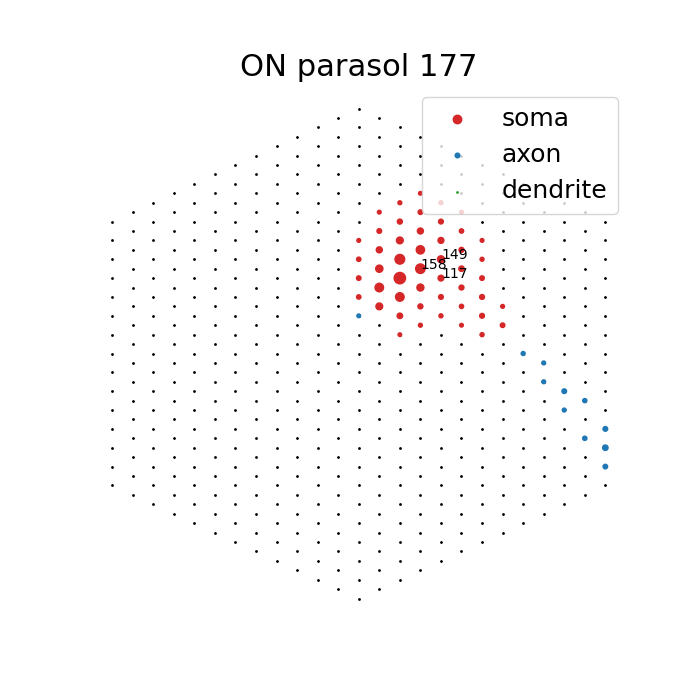

In [43]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data008/data008-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 1
n = 177

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/1112911351.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


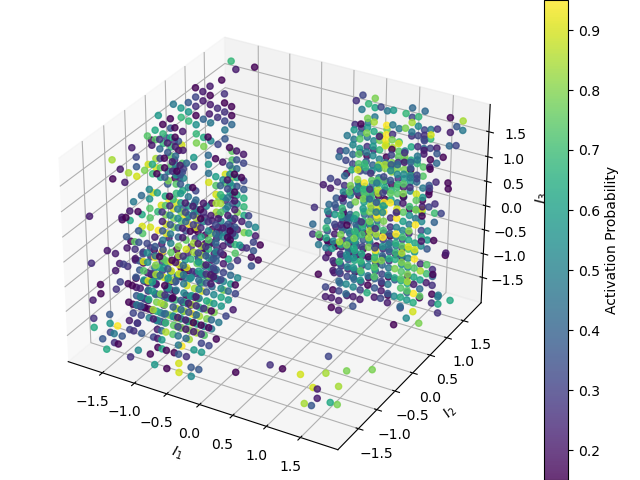

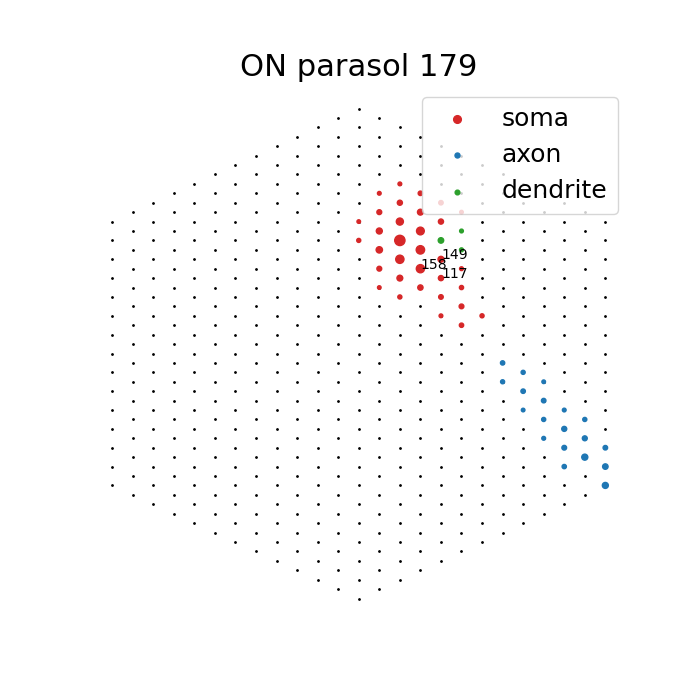

In [44]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data008/data008-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 1
n = 179

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/1144029587.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


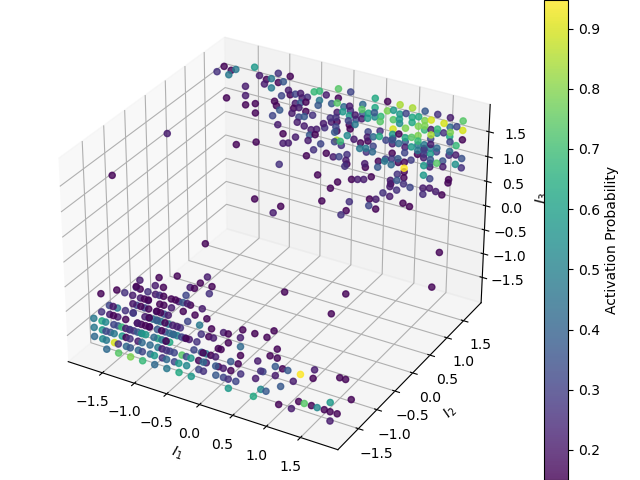

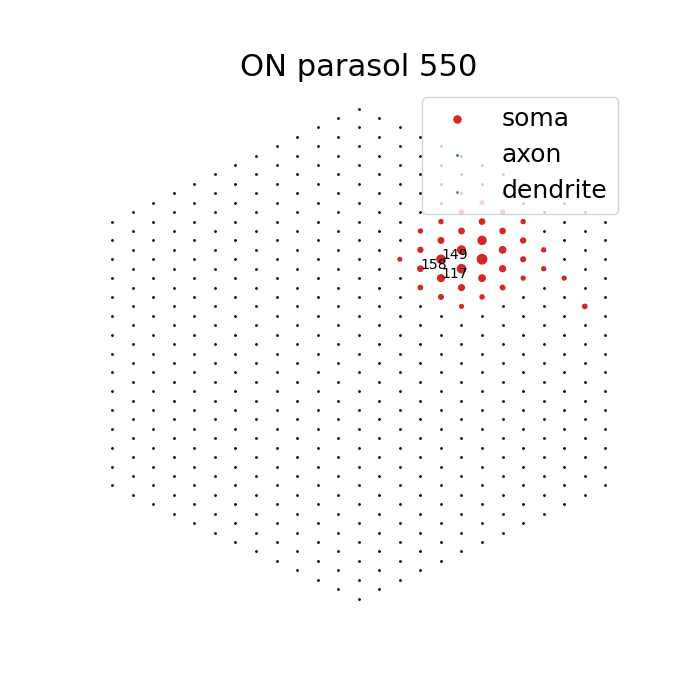

In [45]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data008/data008-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 1
n = 550

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/1978427883.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


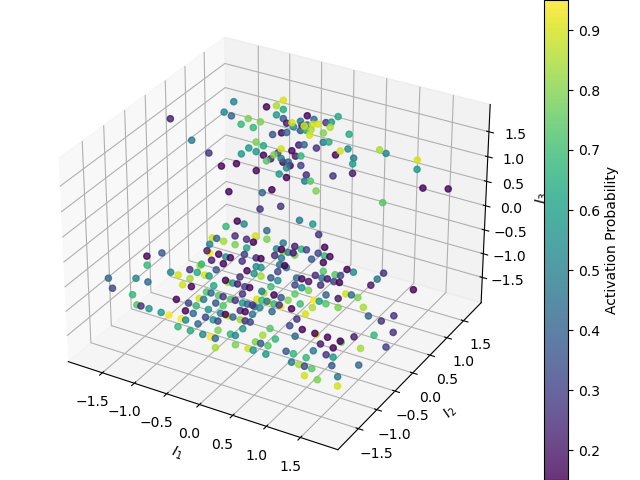

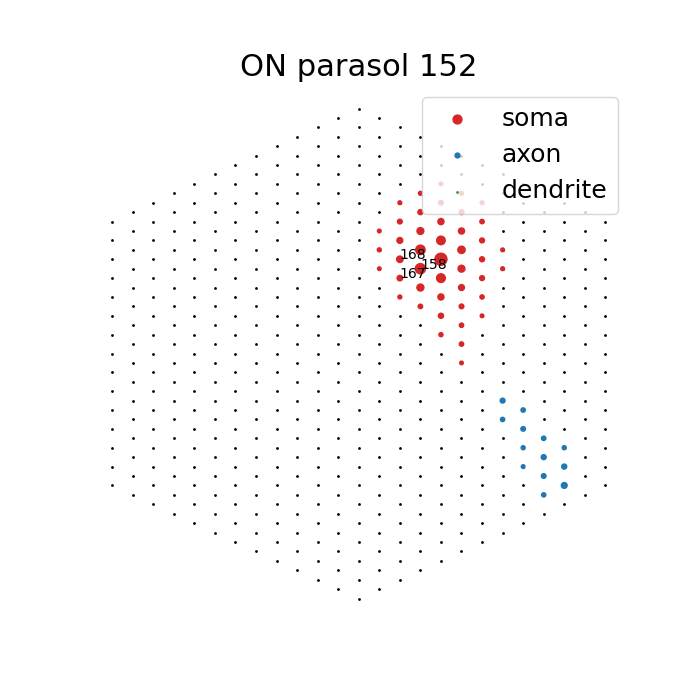

In [46]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data008/data008-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 2
n = 152

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/4224631145.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


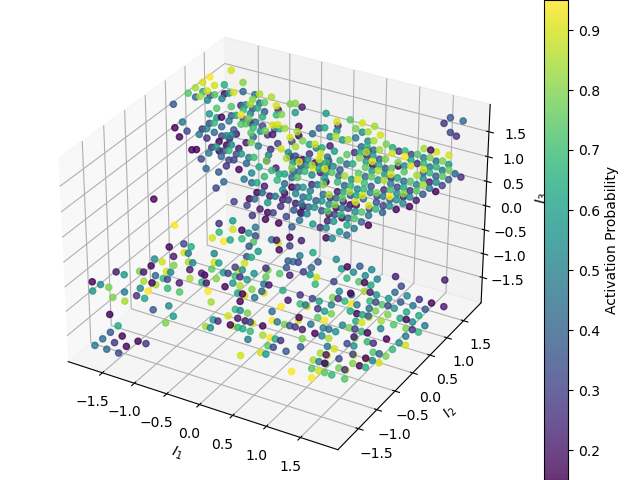

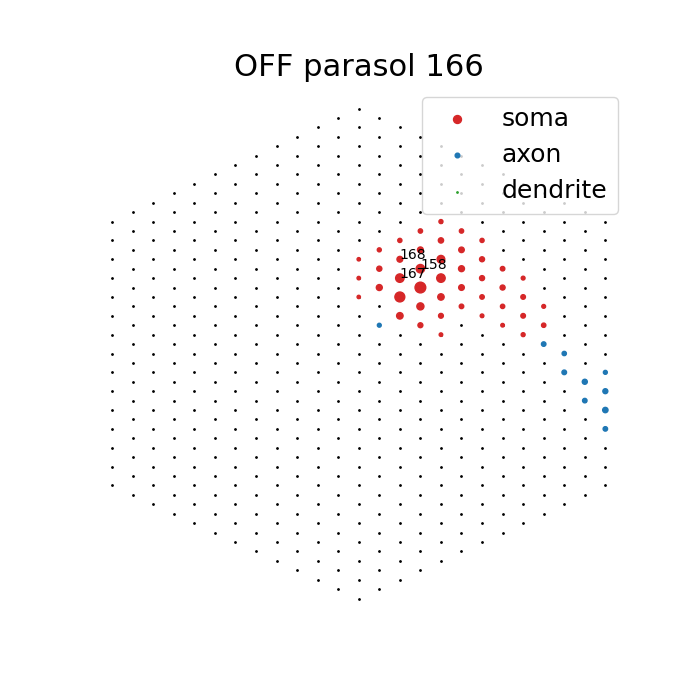

In [47]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data008/data008-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 2
n = 166

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/2470349861.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


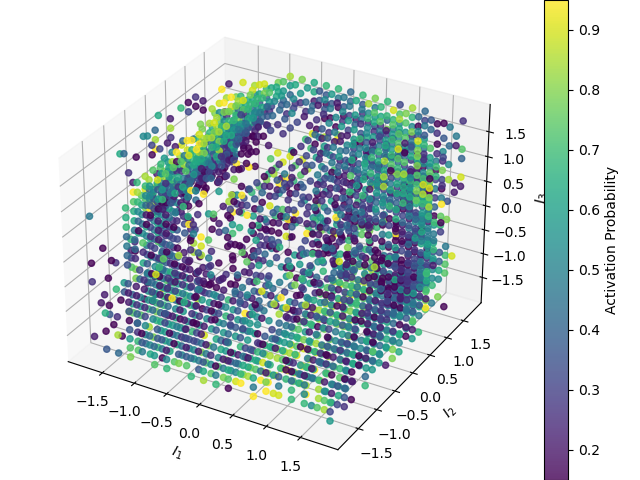

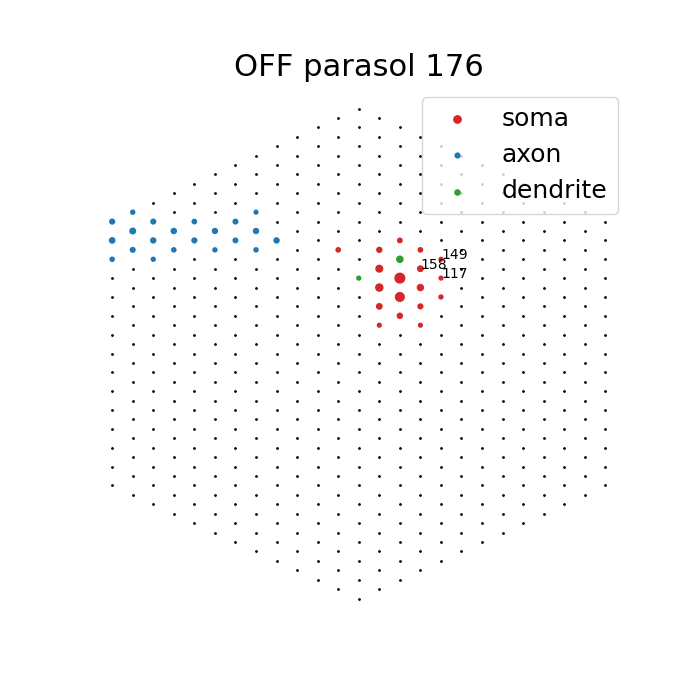

In [48]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data008/data008-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 1
n = 176

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/2607141748.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


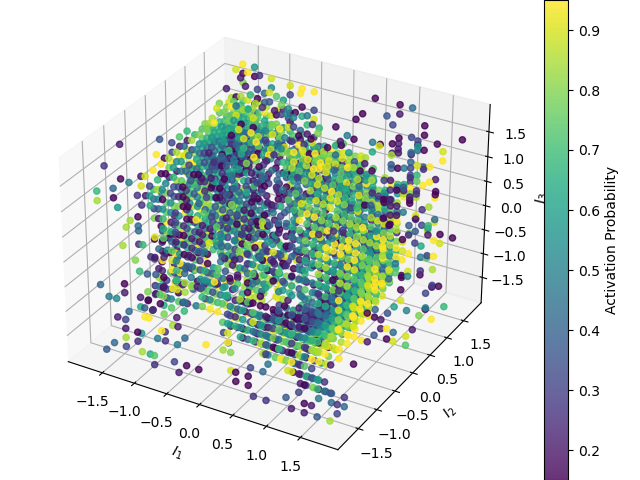

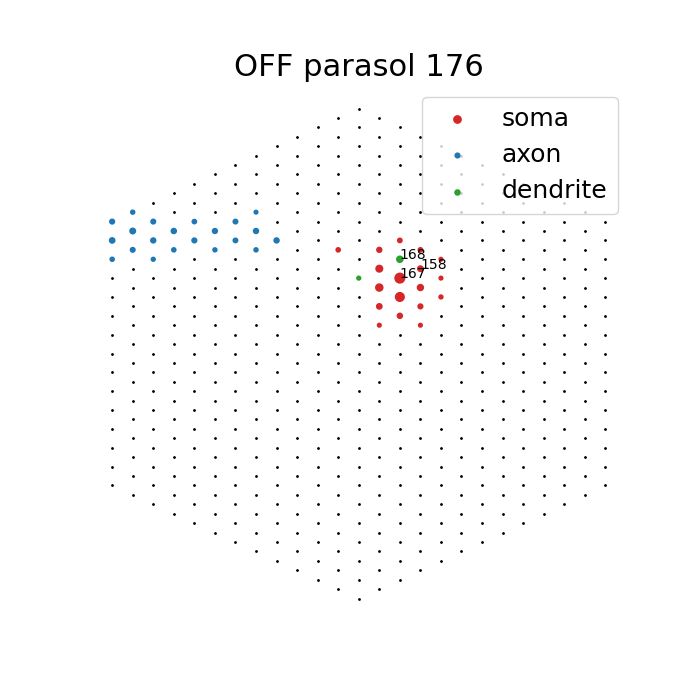

In [49]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data008/data008-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 2
n = 176

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/4246995336.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


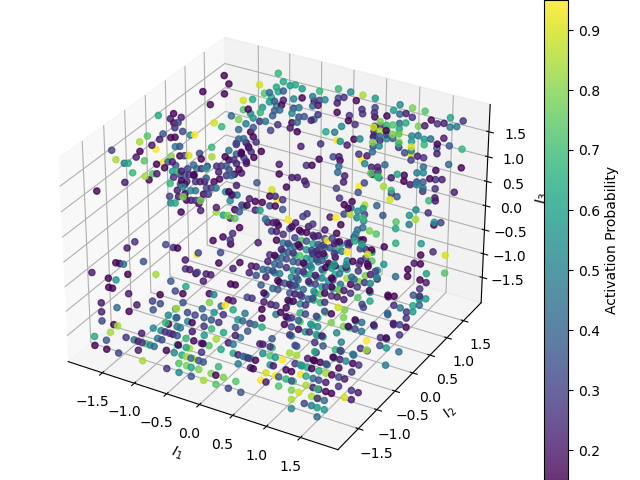

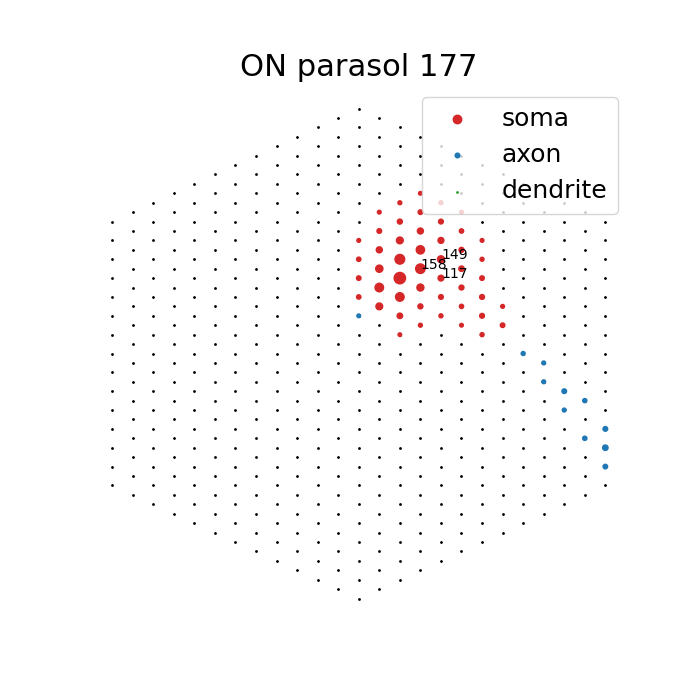

In [50]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data008/data008-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 1
n = 177

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/1311242806.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


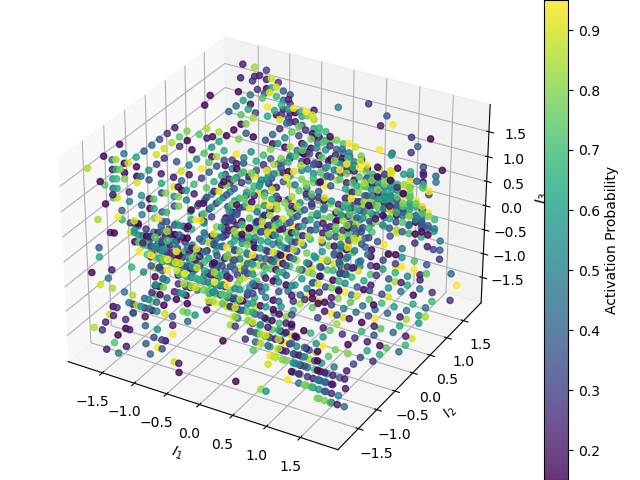

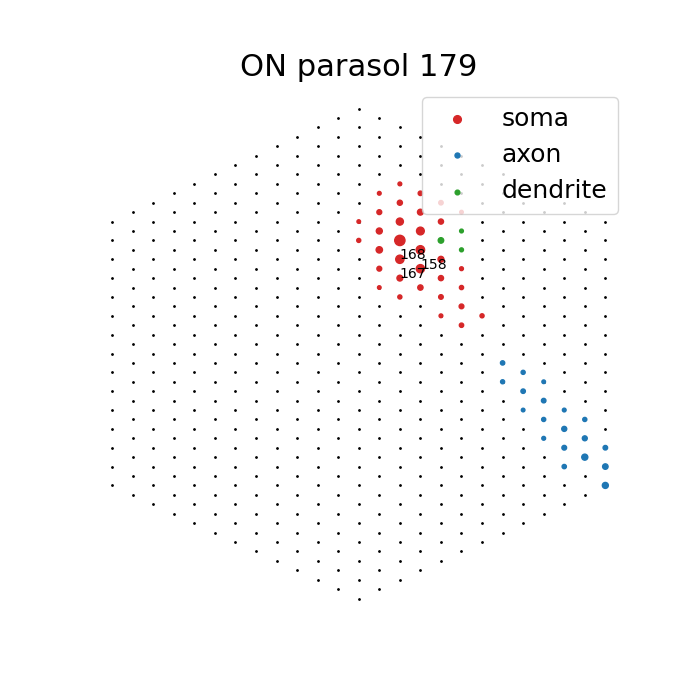

In [51]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data008/data008-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 2
n = 179

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/2681285104.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


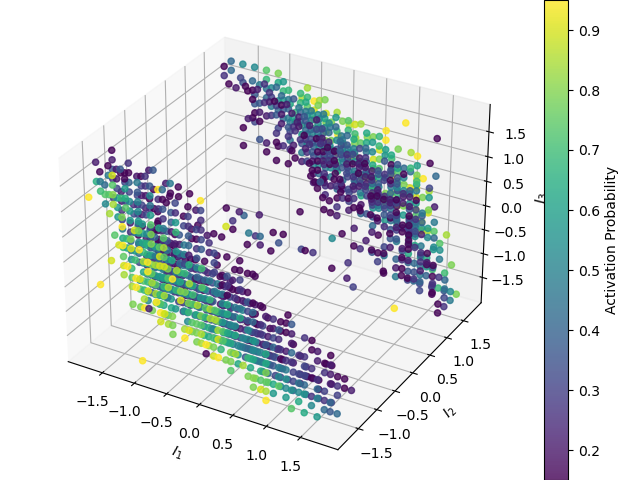

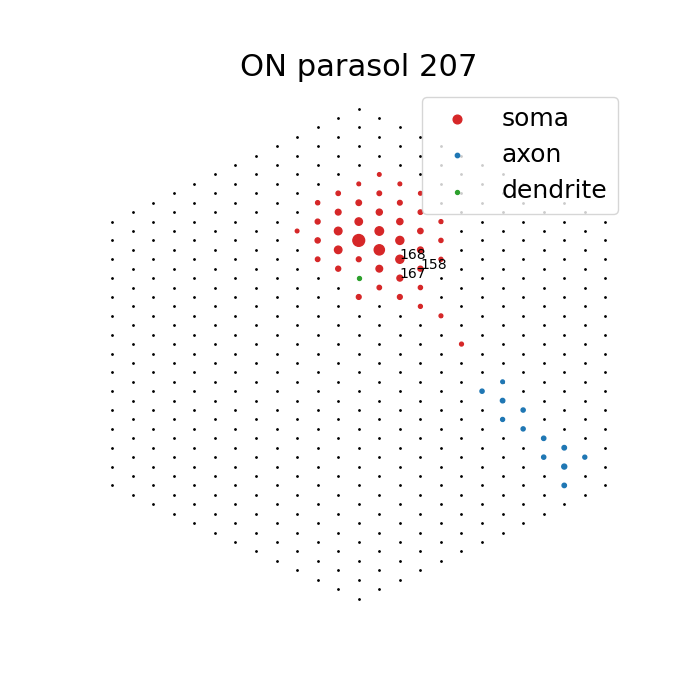

In [52]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-09-29-2"
estim = "data008/data008-all"
wnoise = "kilosort_data002/data002"
thr_factor = 1
p = 2
n = 207

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

# 2020-10-18-0/data003/data003-all

/tmp/ipykernel_27464/2615369877.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


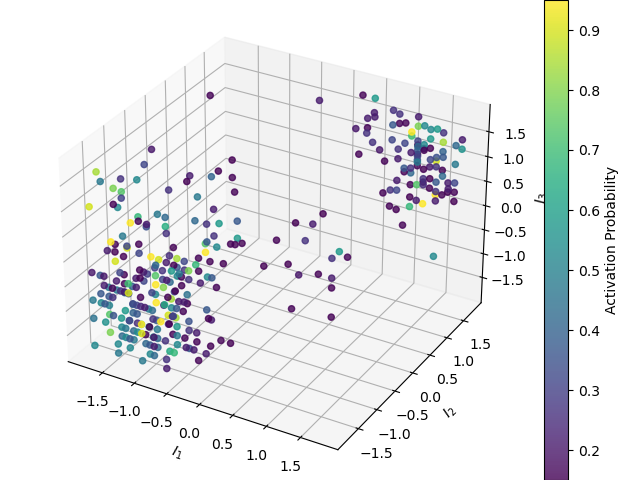

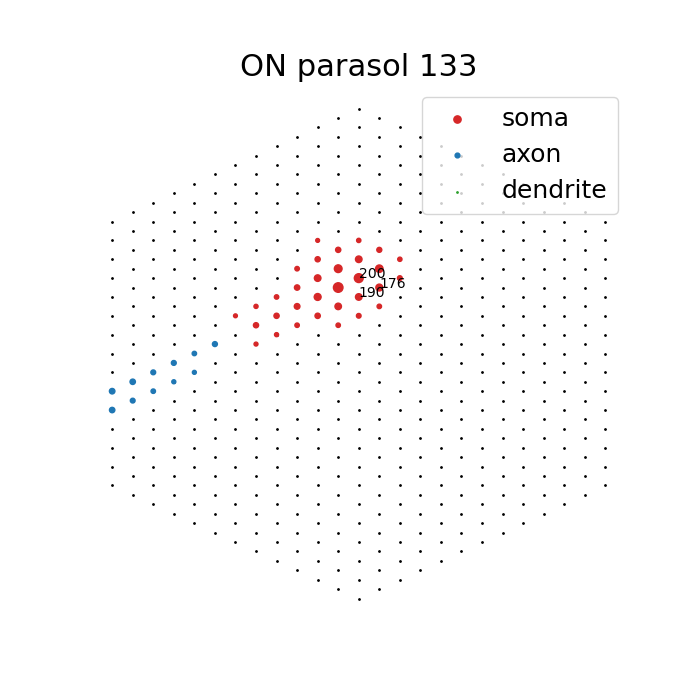

In [53]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-10-18-0"
estim = "data003/data003-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 1
n = 133

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/730498803.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


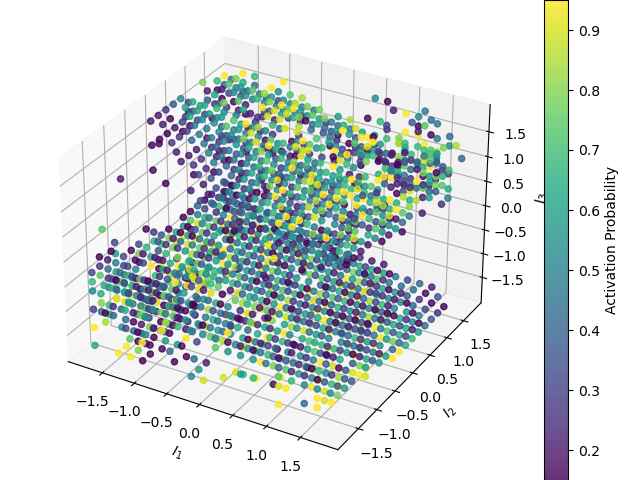

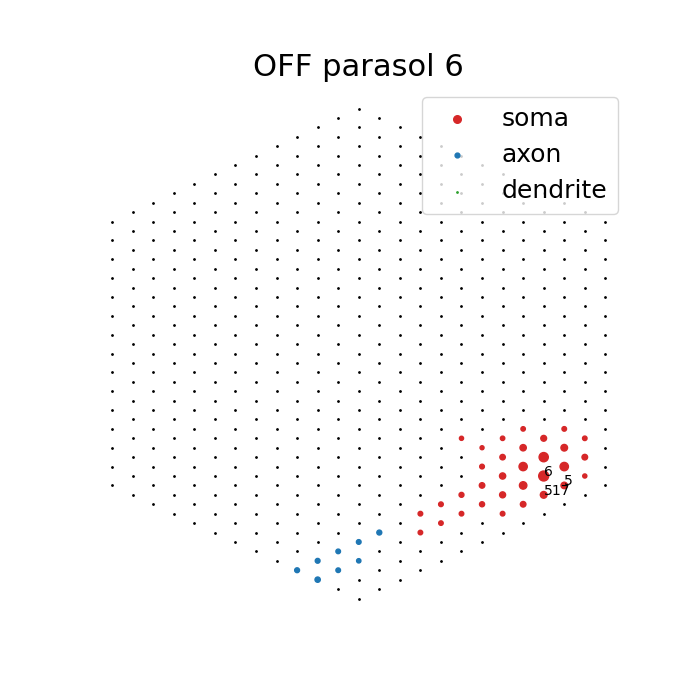

In [54]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-10-18-0"
estim = "data003/data003-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 6

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/1015588900.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


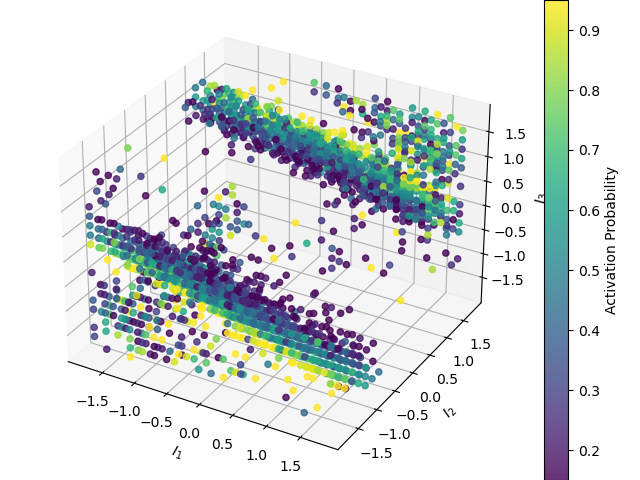

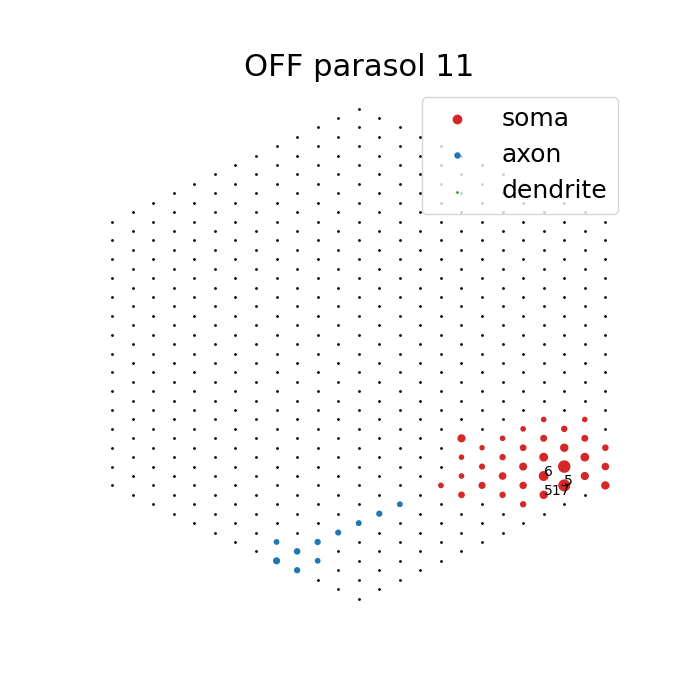

In [55]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-10-18-0"
estim = "data003/data003-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 11

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/1992245979.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


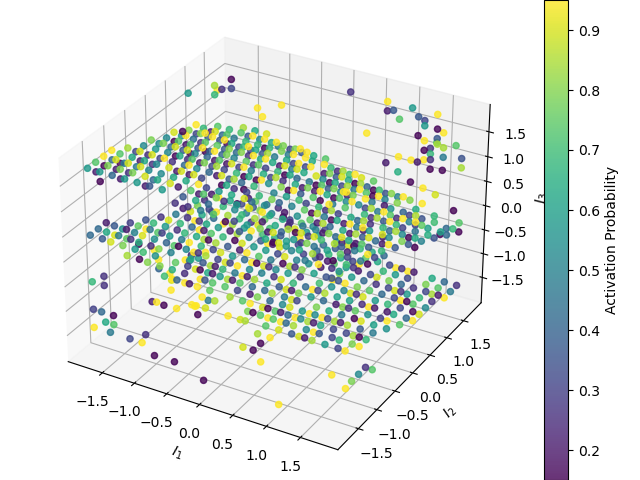

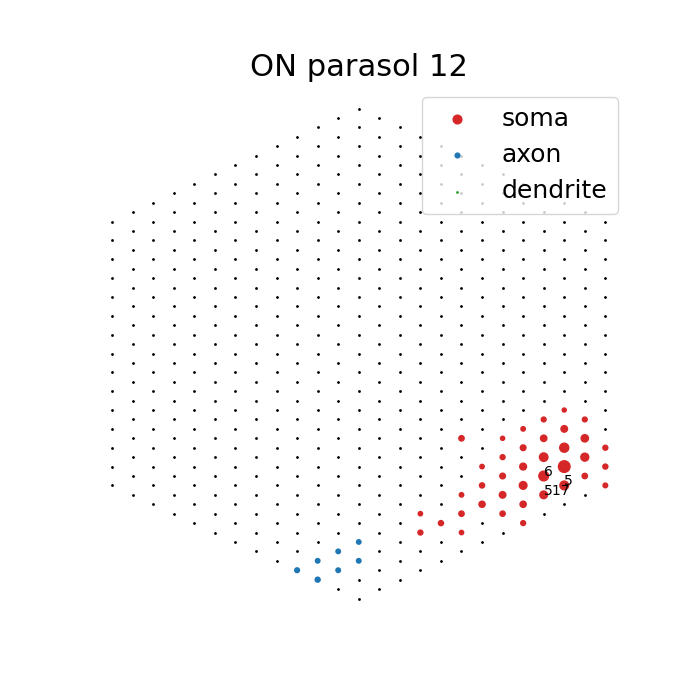

In [56]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-10-18-0"
estim = "data003/data003-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 12

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/2902310425.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


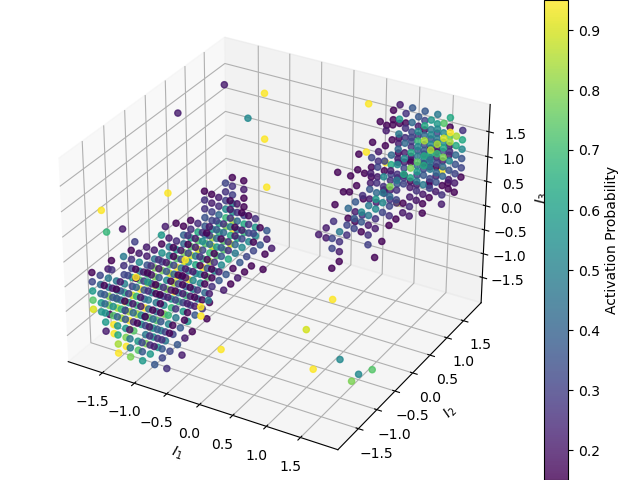

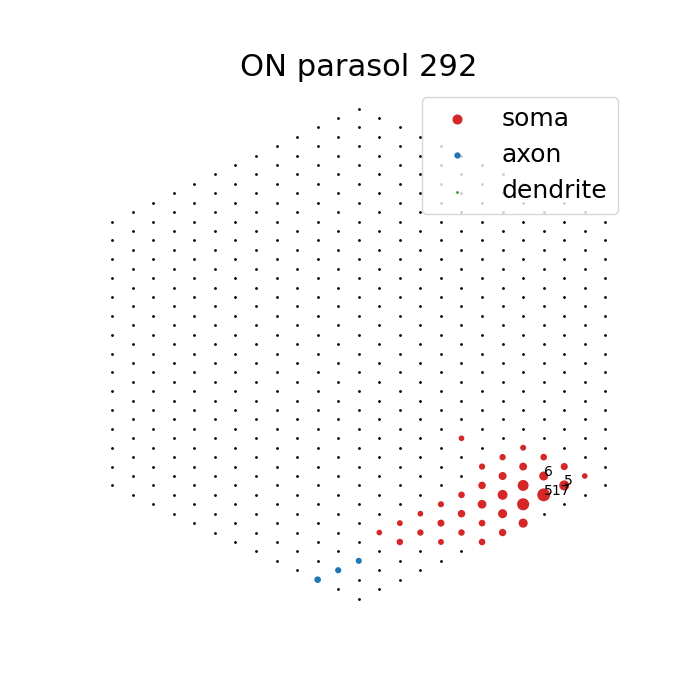

In [57]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-10-18-0"
estim = "data003/data003-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 2
n = 292

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/729071505.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


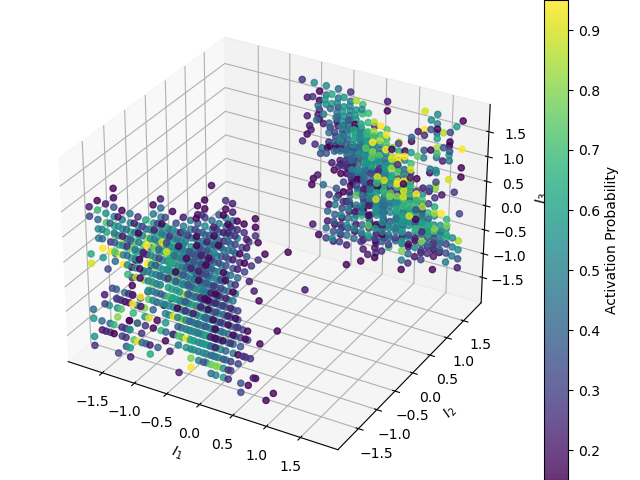

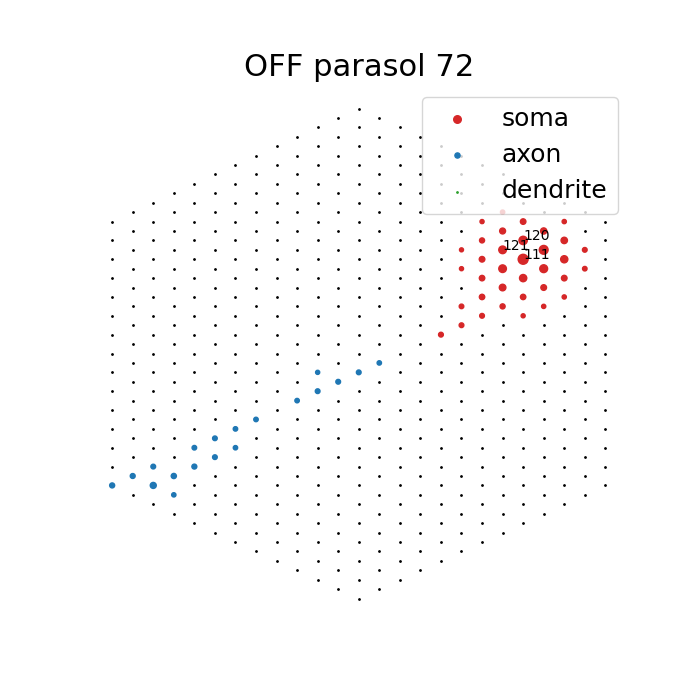

In [58]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-10-18-0"
estim = "data003/data003-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 3
n = 72

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/2739651799.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


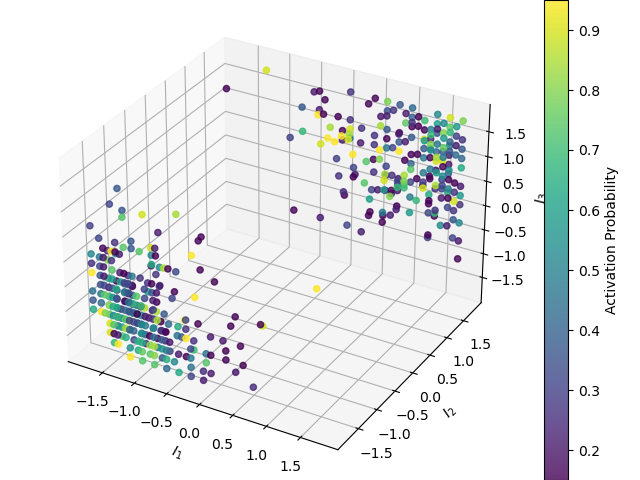

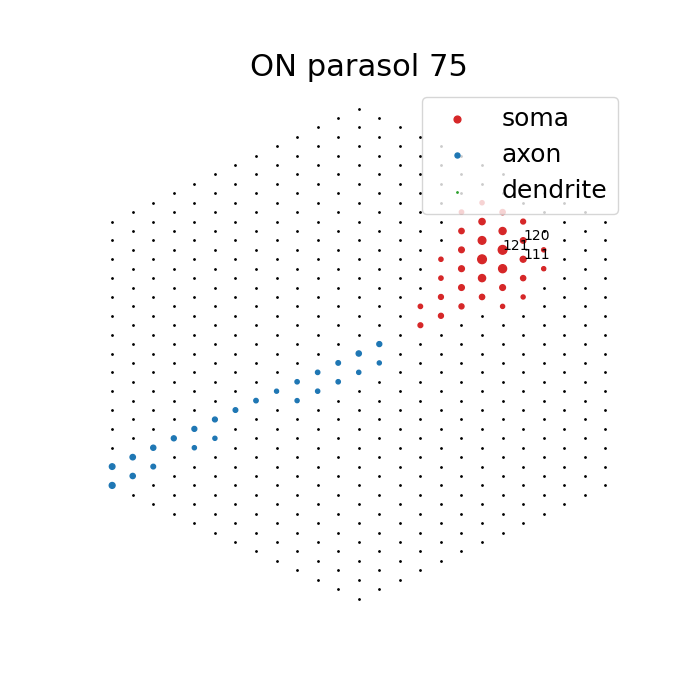

In [59]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-10-18-0"
estim = "data003/data003-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 3
n = 75

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/3877805388.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


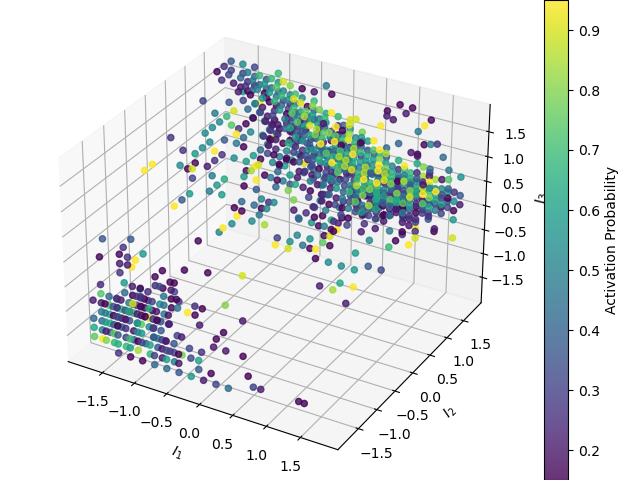

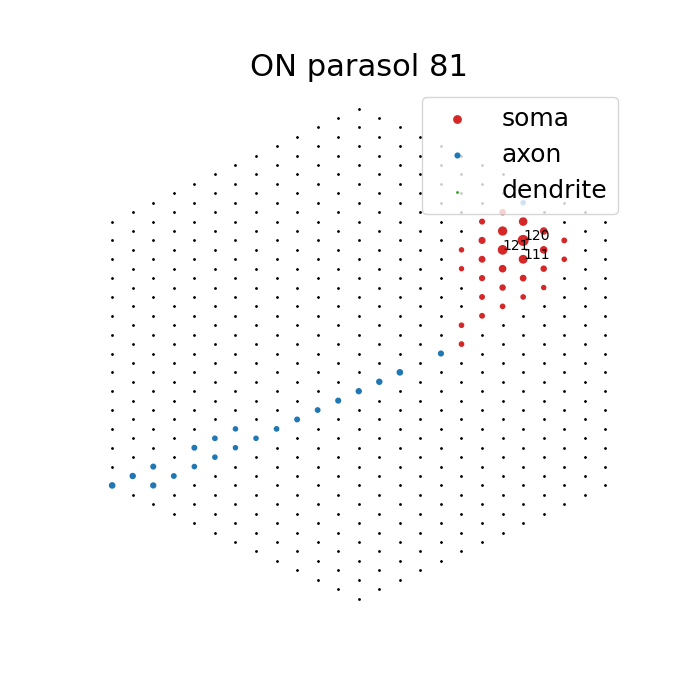

In [60]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-10-18-0"
estim = "data003/data003-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 3
n = 81

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/3983851772.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


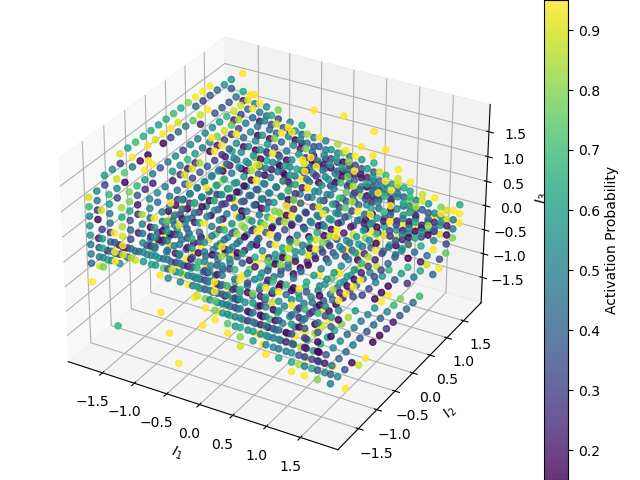

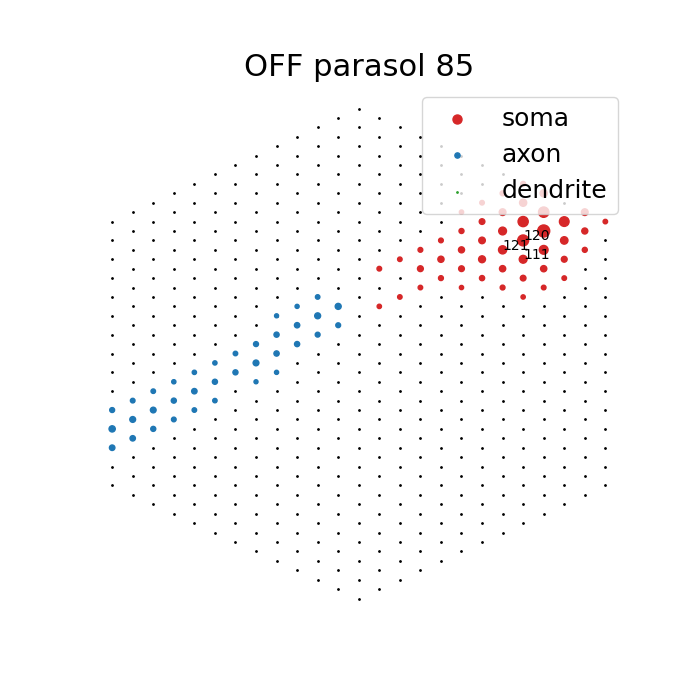

In [61]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2020-10-18-0"
estim = "data003/data003-all"
wnoise = "kilosort_data000/data000"
thr_factor = 1
p = 3
n = 85

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

# 2021-05-27-0/data005/data005-all

/tmp/ipykernel_27464/3886163548.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


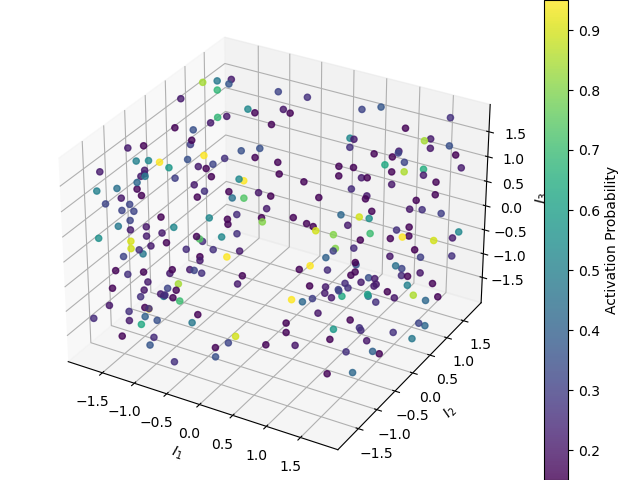

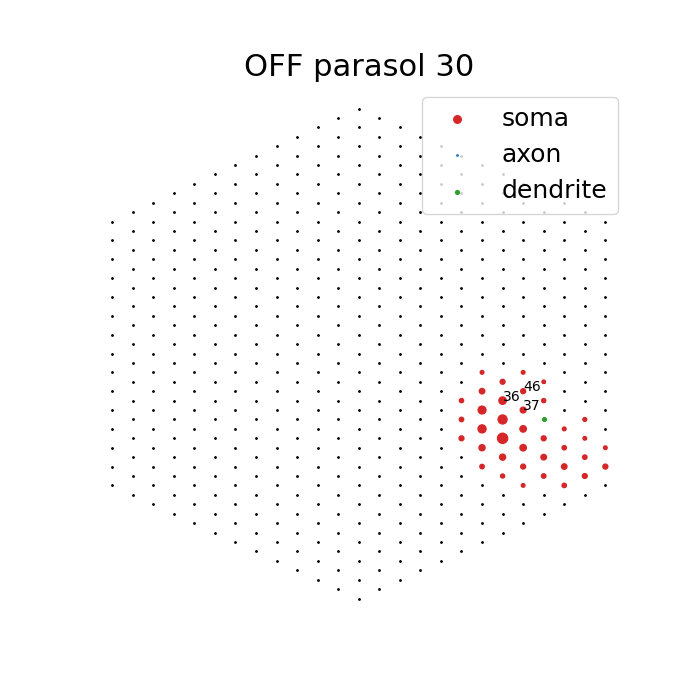

In [62]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 1
n = 30

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/220312013.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


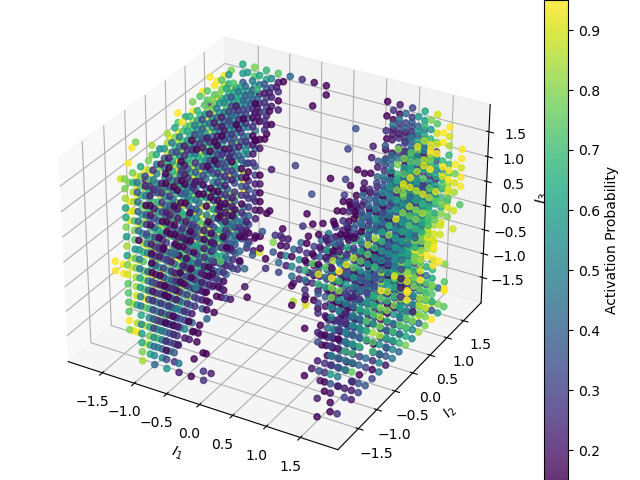

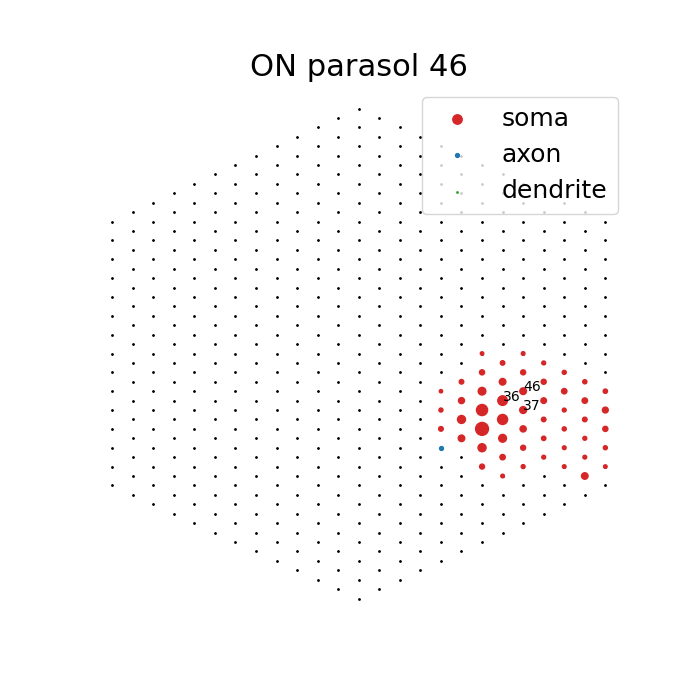

In [63]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 1
n = 46

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/3601577771.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


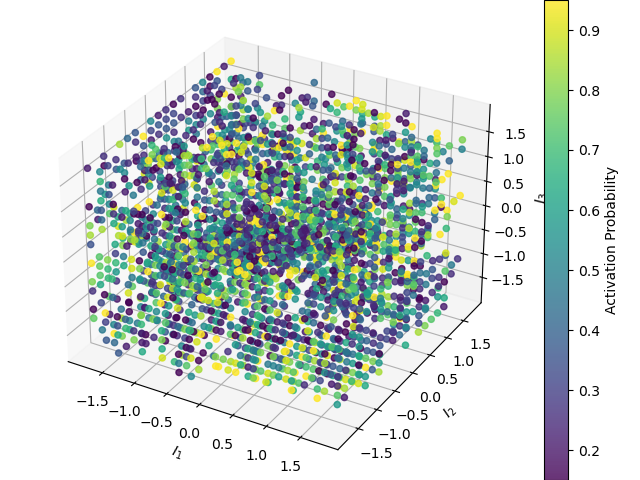

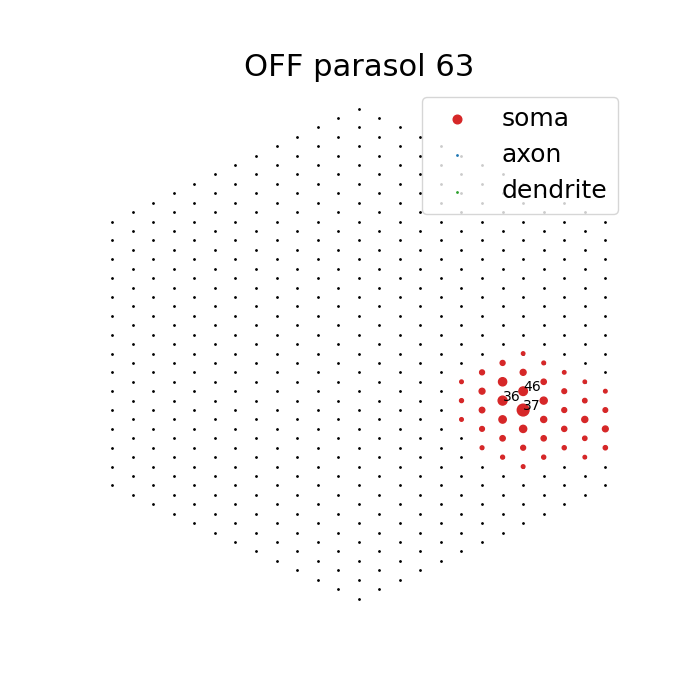

In [64]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 1
n = 63

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/1028925083.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


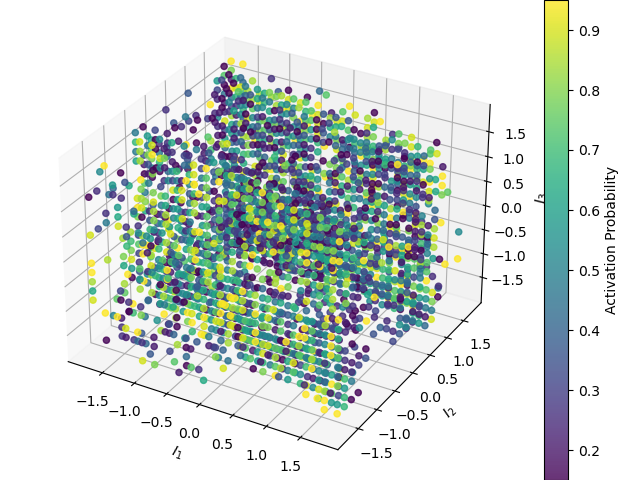

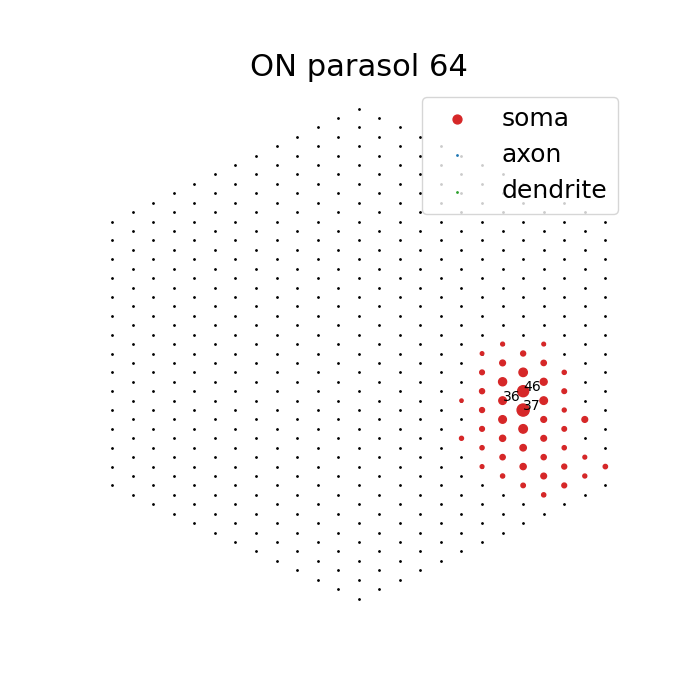

In [65]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 1
n = 64

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/30510105.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


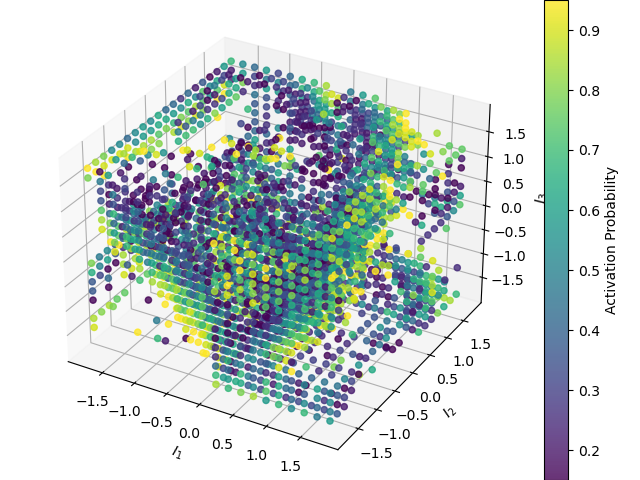

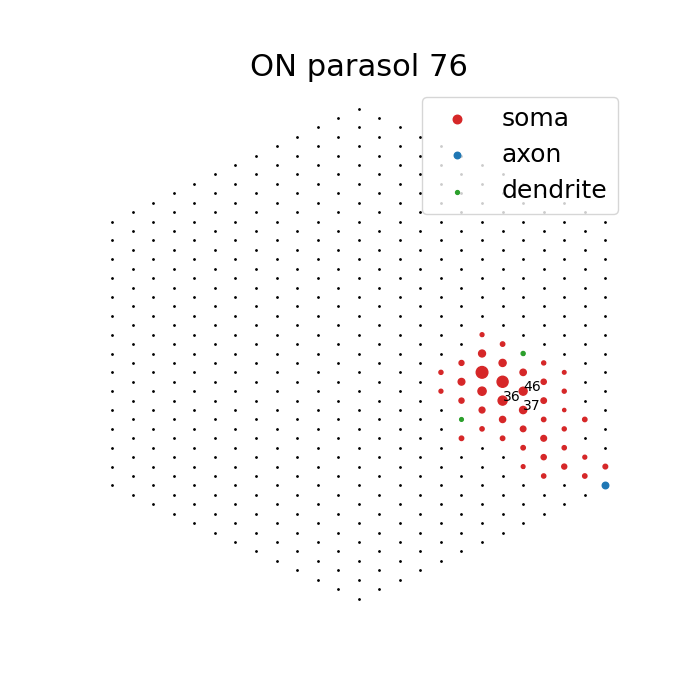

In [66]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 1
n = 76

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/4186234079.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


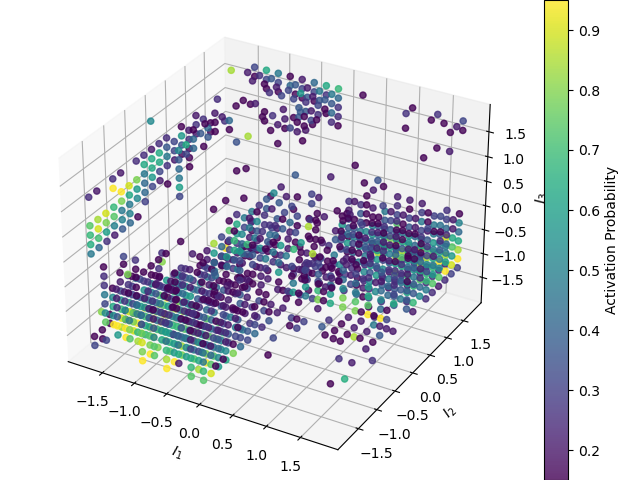

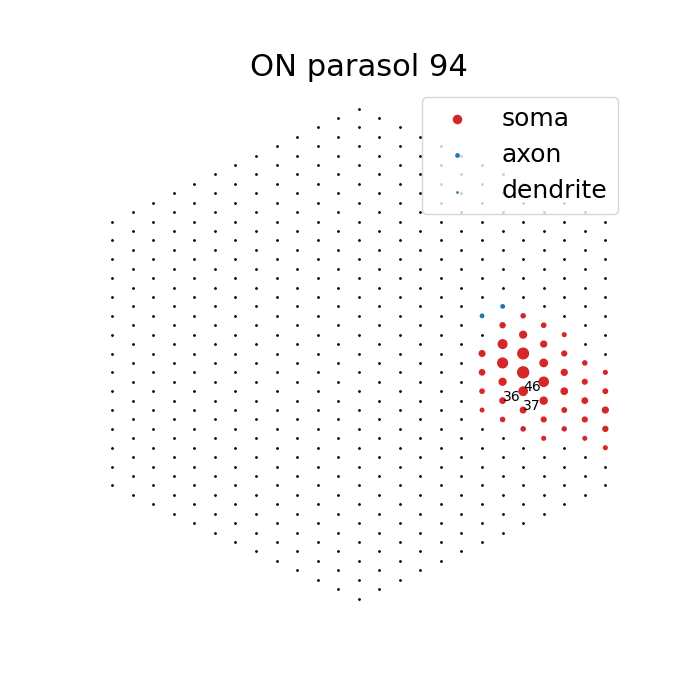

In [67]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 1
n = 94

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/3062222180.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


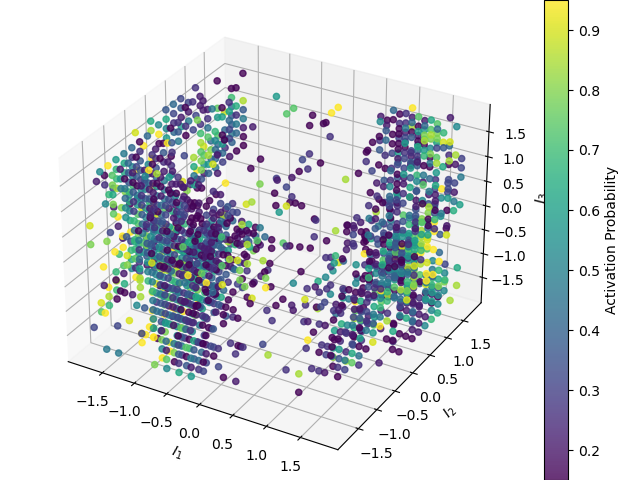

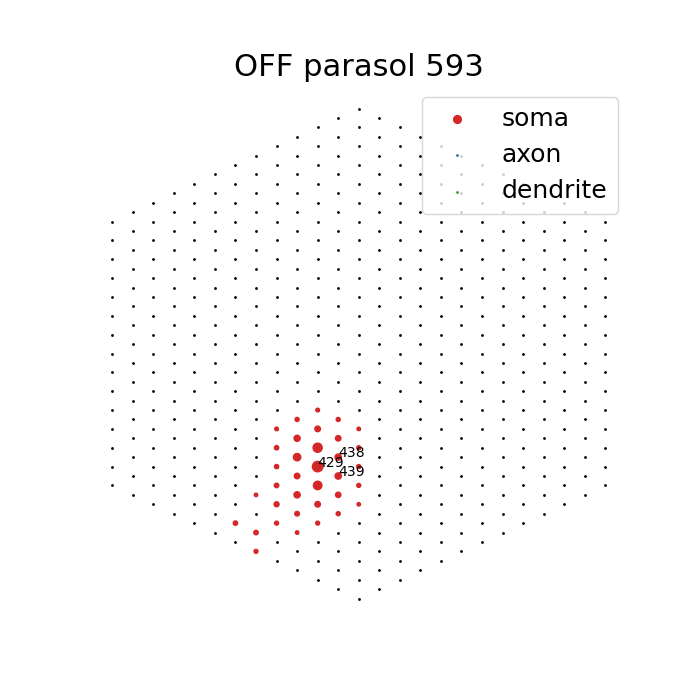

In [68]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 2
n = 593

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/482656254.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


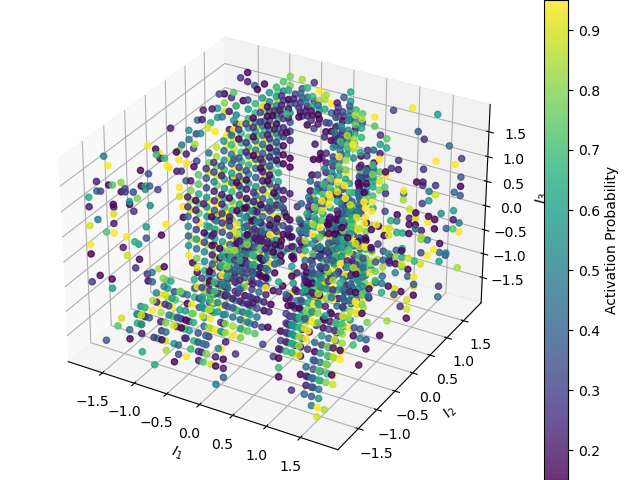

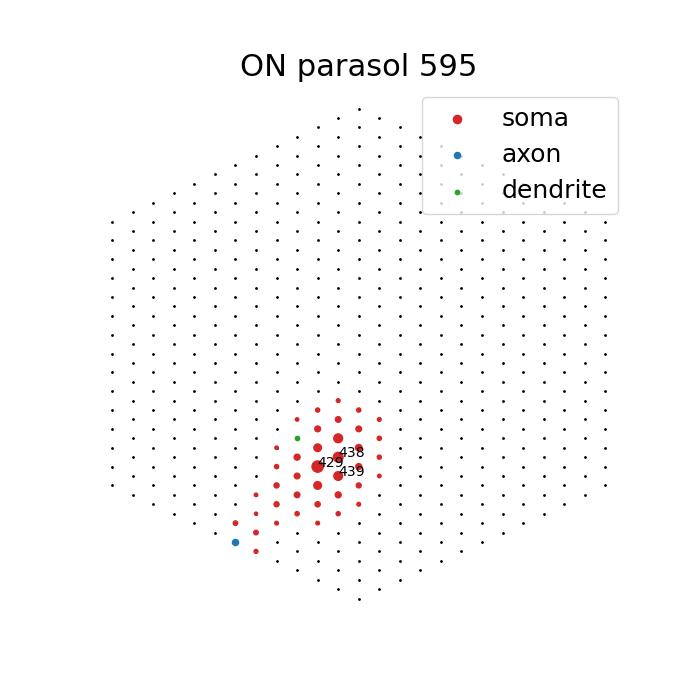

In [69]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 2
n = 595

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/413977620.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


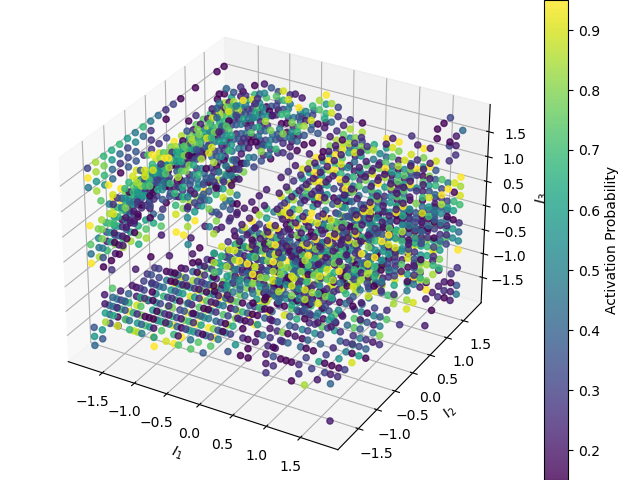

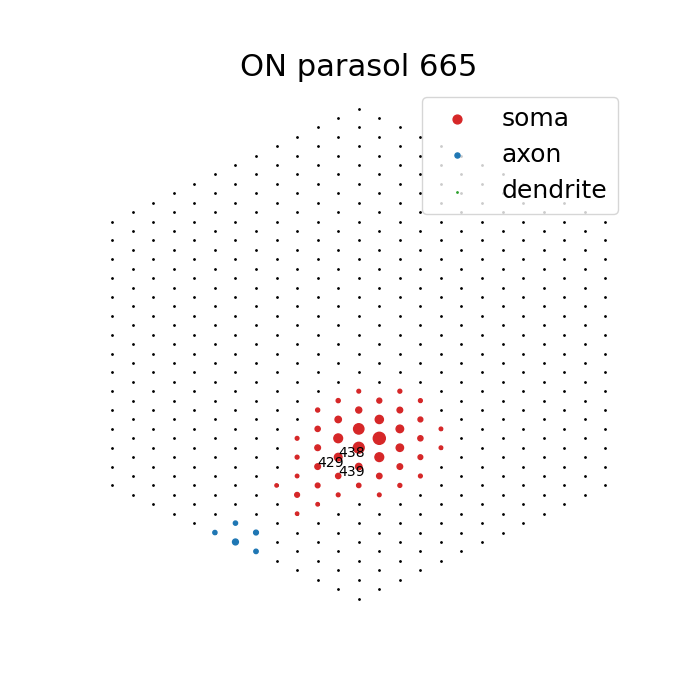

In [70]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 2
n = 665

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/3724130231.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


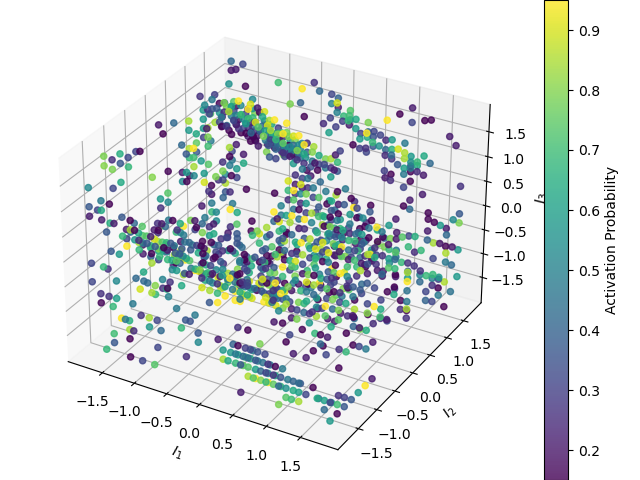

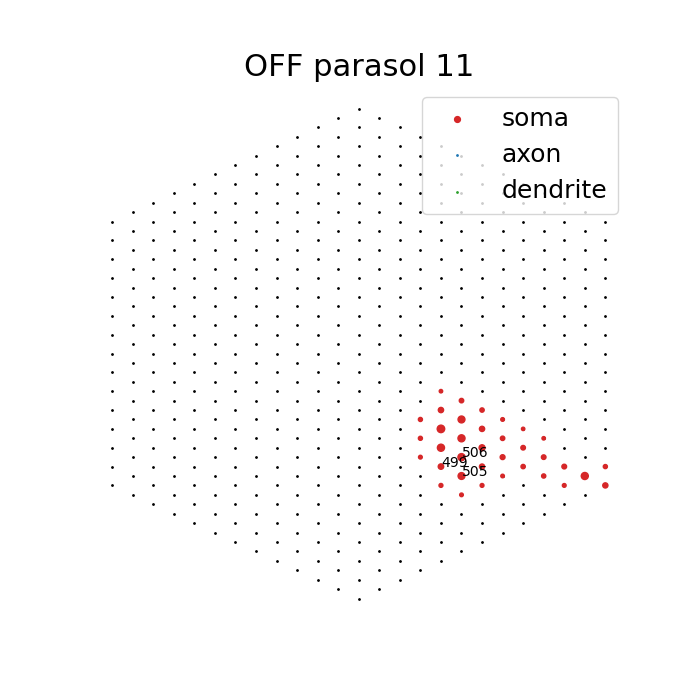

In [71]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 3
n = 11

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/3183254935.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


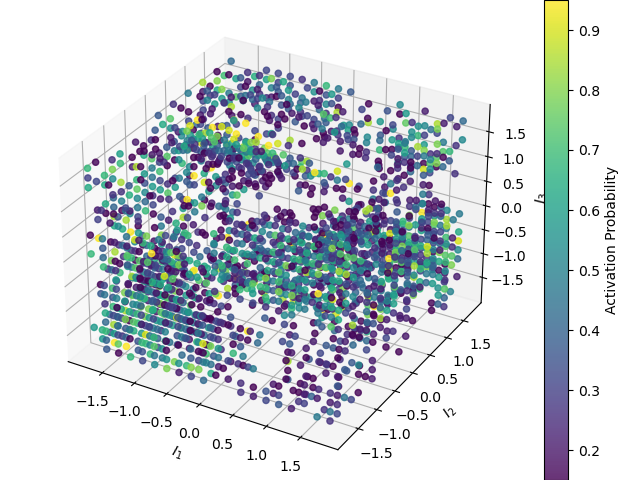

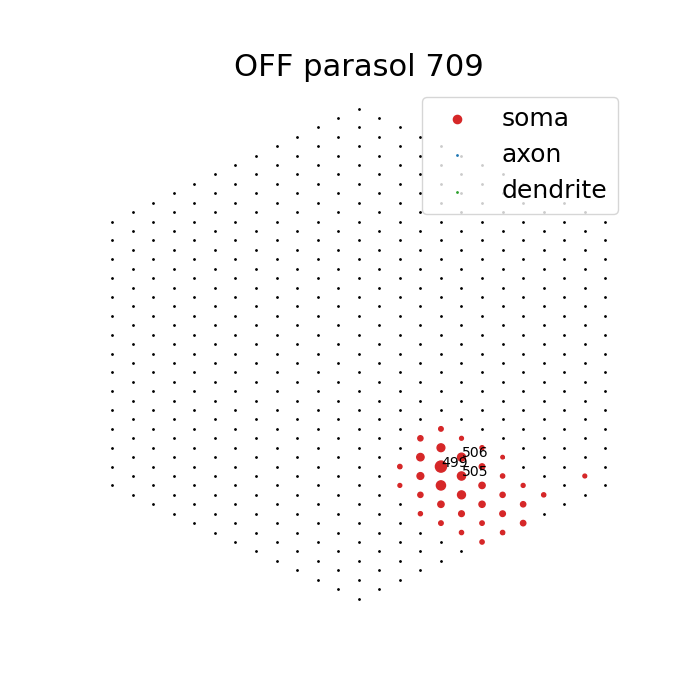

In [72]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 3
n = 709

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/990833303.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


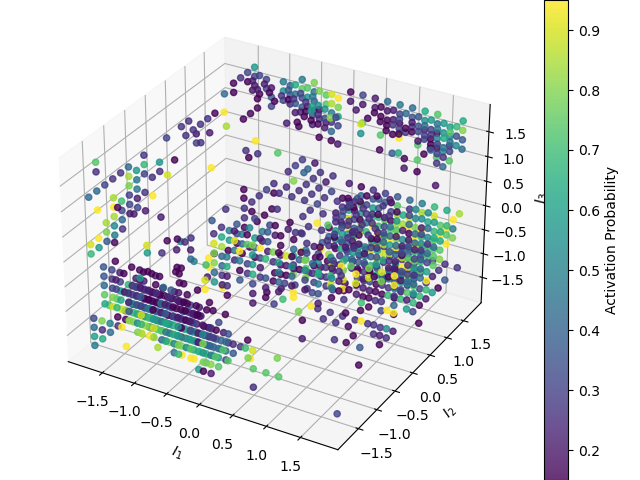

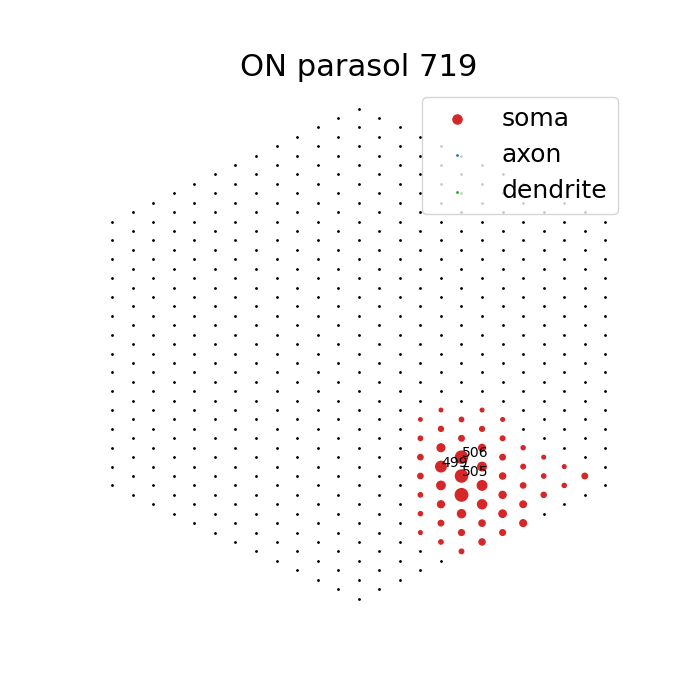

In [73]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 3
n = 719

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/1280530483.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


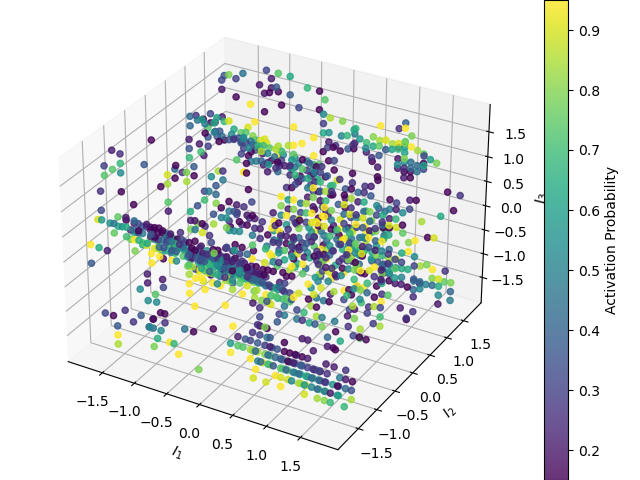

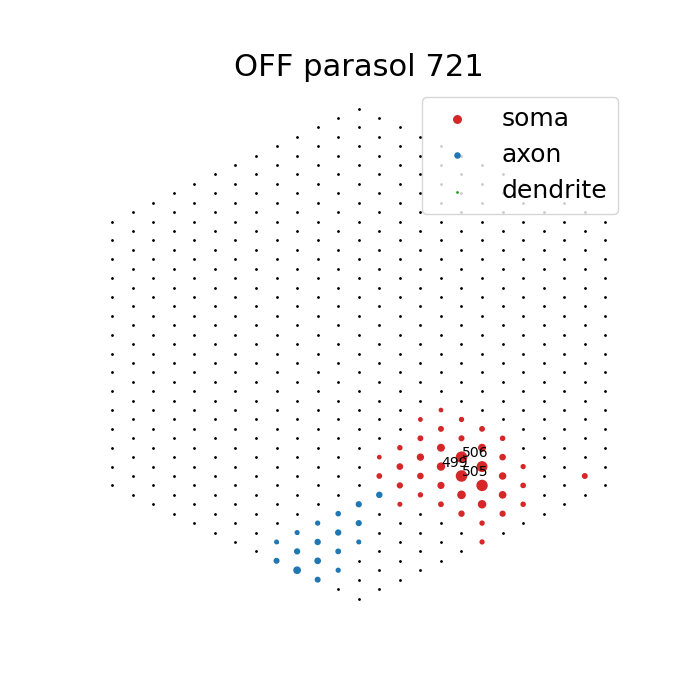

In [74]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 3
n = 721

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/1808035405.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


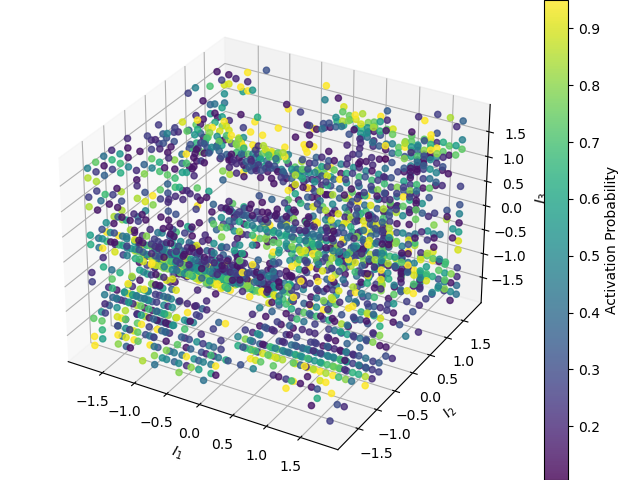

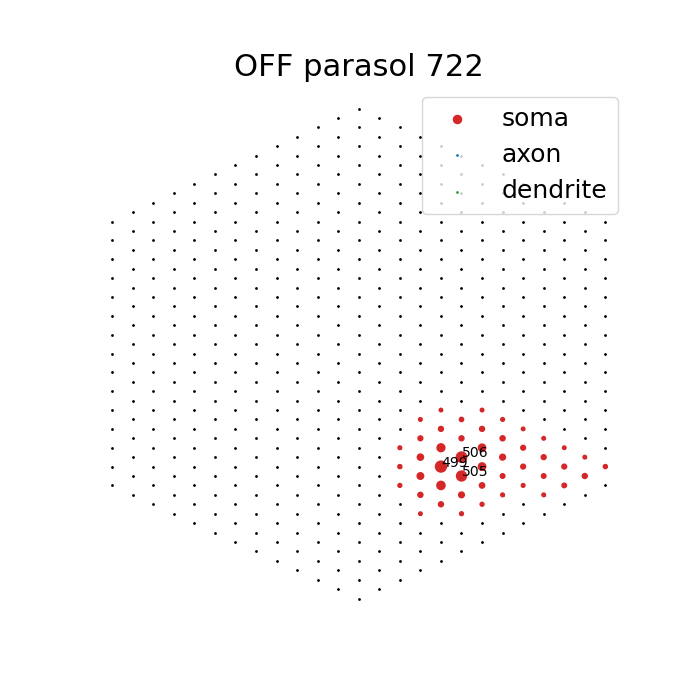

In [75]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 3
n = 722

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()

/tmp/ipykernel_27464/4235145359.py:43: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


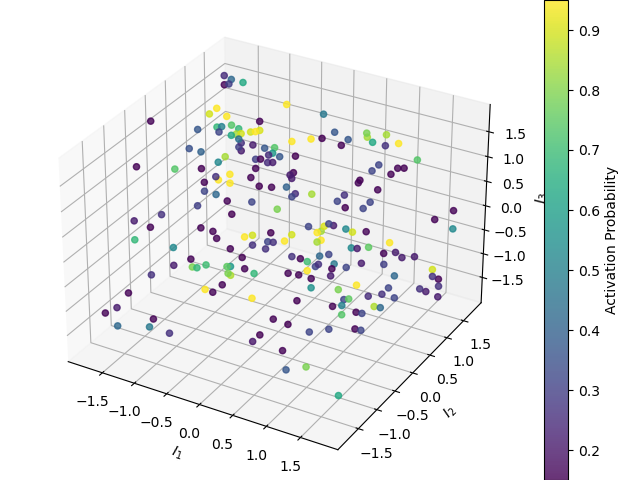

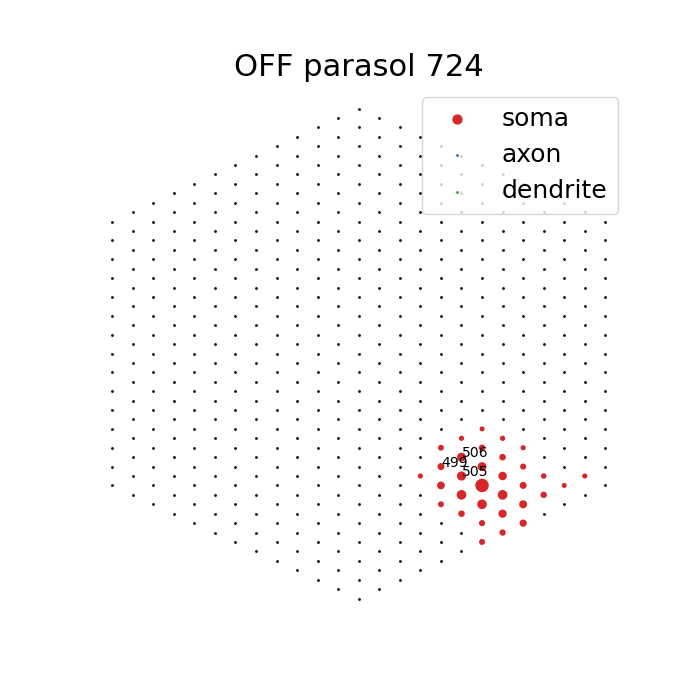

In [76]:
gsort_path = "/Volumes/Scratch/Users/praful/triplet_gsort_v2_30um_raphe-affinity_cosine"
dataset = "2021-05-27-0"
estim = "data005/data005-all"
wnoise = "kilosort_data001/data001"
thr_factor = 1
p = 3
n = 724

p_thr = 2/19
p_upper = 1

electrical_path = os.path.join(ANALYSIS_BASE, dataset, estim)
vis_datapath = os.path.join(ANALYSIS_BASE, dataset, wnoise)
vis_datarun = wnoise.split('/')[-1]
vcd = vl.load_vision_data(
    vis_datapath,
    vis_datarun,
    include_neurons=True,
    include_ei=True,
    include_params=True,
    include_noise=True,
)
channel_noise = vcd.channel_noise
coords = vcd.get_electrode_map()

filepath = os.path.join(gsort_path, 
                        dataset, estim, wnoise, "p" + str(p))

triplet_elecs = mutils.get_stim_elecs_newlv(electrical_path, p)
amplitudes = mutils.get_stim_amps_newlv(electrical_path, p)

num_pts = len(amplitudes)

triplet_probs = np.zeros(num_pts)
for k in range(num_pts):
    with open(os.path.join(filepath, "gsort_tri_v2_n" + str(n) + "_p" + str(p) + "_k" + str(k) + ".pkl"), "rb") as f:
        prob_dict = pickle.load(f)
        triplet_probs[k] = prob_dict["cosine_prob"][0]

good_inds = np.where((triplet_probs > p_thr) & (triplet_probs < p_upper))[0]

fig = plt.figure()
ax = Axes3D(fig)
plt.xlabel(r'$I_1$')
plt.ylabel(r'$I_2$')
ax.set_zlabel(r'$I_3$')

scat = ax.scatter(amplitudes[:, 0][good_inds], 
            amplitudes[:, 1][good_inds],
            amplitudes[:, 2][good_inds], marker='o', s=20, c=triplet_probs[good_inds], alpha=0.8)

clb = plt.colorbar(scat)
clb.set_label('Activation Probability')
plt.show()

fig, ax = plt.subplots(figsize=(7, 7))
ax.scatter(coords[:, 0], coords[:, 1], s=1, c="k")

good_inds, EI = mutils.get_collapsed_ei_thr(vcd, n, thr_factor)
cell_ei = vcd.get_ei_for_cell(n).ei
comp = []
for i in range(len(cell_ei)):
    comp.append(eil.axonorsoma(cell_ei[i]))
comp = np.asarray(comp)

soma_inds = good_inds[np.where(comp[good_inds] == 'soma')]
axon_inds = good_inds[np.where(comp[good_inds] == 'axon')]
dendrite_inds = good_inds[np.where(comp[good_inds] == 'dendrite')]

ax.scatter(coords[soma_inds, 0], coords[soma_inds, 1], s=np.abs(EI[soma_inds]) * 2, c='tab:red', label='soma')
ax.scatter(coords[axon_inds, 0], coords[axon_inds, 1], s=np.abs(EI[axon_inds]) * 2, c='tab:blue', label='axon')
ax.scatter(coords[dendrite_inds, 0], coords[dendrite_inds, 1], s=np.abs(EI[dendrite_inds]) * 2,
            c='tab:green', label='dendrite')
plt.title(vcd.get_cell_type_for_cell(n) + " " + str(n), fontsize=22)

for i, txt in enumerate(triplet_elecs):
    ax.annotate(txt, (coords[triplet_elecs[i]-1, 0], coords[triplet_elecs[i]-1, 1]), c='k')

ax.axis('off')
ax.legend(fontsize=18, loc="upper right")
plt.show()